# Librarys

In [1]:
#import the cNoise function
import numpy as np
import pandas as pd
from tqdm import tqdm
from matplotlib.pyplot import figure
import matplotlib.pyplot as plt
import cv2
import plotly.graph_objects as go
from matplotlib.gridspec import GridSpec
import matplotlib.gridspec as gridspec

In [2]:
from NCGL  import cNoise
import numpy as np
import pandas as pd
from matplotlib.pyplot import figure
import matplotlib.pyplot as plt
import cv2
from ordpy import *
from GPA import GPA

# Functions

In [3]:
def getHistogramSlices(mat):
    freq = np.fft.fftfreq(mat.shape[0])
    p = (freq > 1e-12)
    betas= []
    for i in range(mat.shape[0]): 
        psd = np.fft.fft(mat[i])
        psd = (psd*np.conj(psd)).real
        b,_ = np.polyfit(np.log(freq[p]),np.log(psd[p]),deg=1)
        betas.append(-b)
    for i in range(mat.shape[1]):
        psd = np.fft.fft(mat[:,i])
        psd = (psd*np.conj(psd)).real
        b,_ = np.polyfit(np.log(freq[p]),np.log(psd[p]),deg=1)
        betas.append(-b)
    return betas

def getMONOHistogramSlices(data):
    betas = []
    for i in range(len(data)):
        freq = np.fft.fftfreq(len(data[i]))
        p = (freq > 1e-12)
        psd = np.fft.fft(data[i])
        psd = (psd*np.conj(psd)).real
        b,_ = np.polyfit(np.log(freq[p]),np.log(psd[p]),deg=1)
        betas.append(-b)
    return betas
#radio = getMONOHistogramSlices(image_data)


def getBiHistogramSlices(mat):
    freq = np.fft.fftfreq(mat.shape[0])
    p = (freq > 1e-12)
    betas_x, betas_y = [], []
    for i in range(mat.shape[0]):
        psd = np.fft.fft(mat[i])
        psd = (psd*np.conj(psd)).real
        b,_ = np.polyfit(np.log(freq[p]),np.log(psd[p]),deg=1)
        betas_x.append(-b)
    for i in range(mat.shape[1]):
        psd = np.fft.fft(mat[:,i])
        psd = (psd*np.conj(psd)).real
        b,_ = np.polyfit(np.log(freq[p]),np.log(psd[p]),deg=1)
        betas_y.append(-b)
    return betas_x,betas_y    

import numpy as np
import matplotlib.pyplot as plt

# Define the mean and covariance matrix of the Gaussian distribution
def plot_psd_conter(image,title):
  data_x,data_y = getBiHistogramSlices(image)
  mu = np.array([np.mean(data_x), np.mean(data_y)])
  cov = np.cov(data_x,data_y)#np.array([[1, 0], [0, 1]])

  # Define a grid of x and y values
  x = data_x#np.linspace(-3, 3, 100)
  y = data_y#np.linspace(-3, 3, 100)
  X, Y = np.meshgrid(x, y)

  # Evaluate the Gaussian distribution at each point on the grid
  Z = np.zeros_like(X)
  for i in range(len(x)):
      for j in range(len(y)):
          p = np.array([x[i], y[j]])
          Z[j,i] = np.exp(-0.5*(p-mu).T @ np.linalg.inv(cov) @ (p-mu))

  # Create a contour plot of the Gaussian distribution
  plt.contour(X, Y, Z)
  plt.title('$\\beta_c$ = '+str(title)+' - $\\beta_\\mu$ ='+str(abs(round(np.mean(data_x+data_y),5))))
  # plt.xlabel('x')
  # plt.ylabel('y')
  #plt.show()

def plot_psd(data,label='PSD',color='k',is_subplot = False):
  '''
  This functions will show the PSD representation for any time series
  '''
  ft = np.fft.fft(data)
  ft = np.real(ft*np.conj(ft))
  freq = np.fft.fftfreq(len(ft))
  seq = np.argsort(freq)
  a,b = np.polyfit(np.log(freq[freq>0.0]),np.log(ft[freq>0.0]),deg=1)
  text = "{} {}f + {}".format(label,np.round(a,3),np.round(b,3))
  #plota o psd
  if is_subplot:
    return freq[seq],ft[seq]
  else:
    return plt.loglog(freq[seq],ft[seq],color=color,label=text)    


# Data Set
You can *Generate* or *Load dataset*

## Generate Data Set

In [5]:
# #Generating the data

# images_for_classes = 1

# #Generating several colored noise from `cNoise` mudule
# #%%capture
# size = 1024
# min_beta = 0
# max_beta = 3
# n_classes = 5
# noise = []
# beta  = []

# for i in range(0,(max_beta-min_beta)*n_classes+1):
#   print(' Noise: Beta '+str(i/n_classes))
# print(f'It will be {i} classes and {images_for_classes} images for classes')

In [6]:
# for j in range(0,images_for_classes):
#   for i in range(0,(max_beta-min_beta)*n_classes+1):
#     noise.append(cNoise(i/n_classes,(size,size),maxCorrections=100,maxAvgError=0.001, eta=0.05))
#     beta.append(i/n_classes)
#     print('data_set '+str(j)+' Noise: Beta '+str(i/n_classes))

# df_data = pd.DataFrame({'image':noise, 'class':beta})
# df_data
# df_data.to_pickle('MultipleCNN_Noise2.plk')


## Load Data

### Load From PC

In [7]:
#os.chdir('/content/drive/MyDrive/INPE/CCN_For_Noise_Classification/')
# df_data_all =  pd.read_pickle('/media/barauna/Compartilhado/Academia/Doutorado/P1_Vision_Noise/MultipleCNN_Noise.plk')
df_data_all =  pd.read_pickle('/home/barauna/MEGA/Academia/DOUTORADO/Tese/data/MultipleCNN_Noise.plk')
df_data_all2 =  pd.read_pickle('/home/barauna/MEGA/Academia/DOUTORADO/Tese/data/MultipleCNN_Noise2.plk')


# Data Analyses

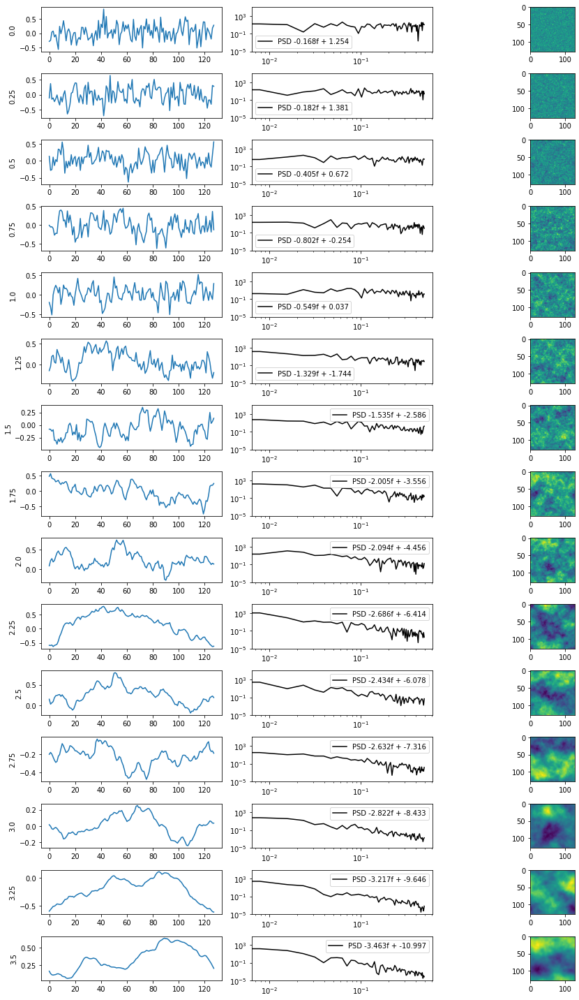

In [16]:
plt.figure(figsize = (13,20))

chosed_len = 15

for i in range(chosed_len):
   plt.subplot(chosed_len,3,3*i+1)
   plt.plot(df_data_all['image'][i][0])
   plt.ylabel(df_data_all['class'][i])

   plt.subplot(chosed_len,3,3*i+2)
   plot_psd(df_data_all['image'][i][0])
   plt.ylim(1e-5,1e5)
   plt.legend()

   plt.subplot(chosed_len,3,3*i+3)
   #plt.title('β = '+str(df_data_all['class'][i]))
   plt.imshow(df_data_all['image'][i])   
plt.tight_layout()

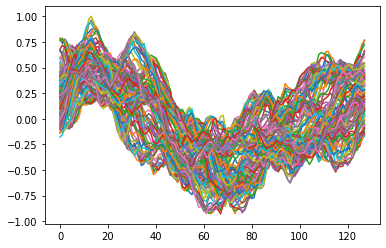

In [36]:
plt.plot(df_data_all['image'][10])

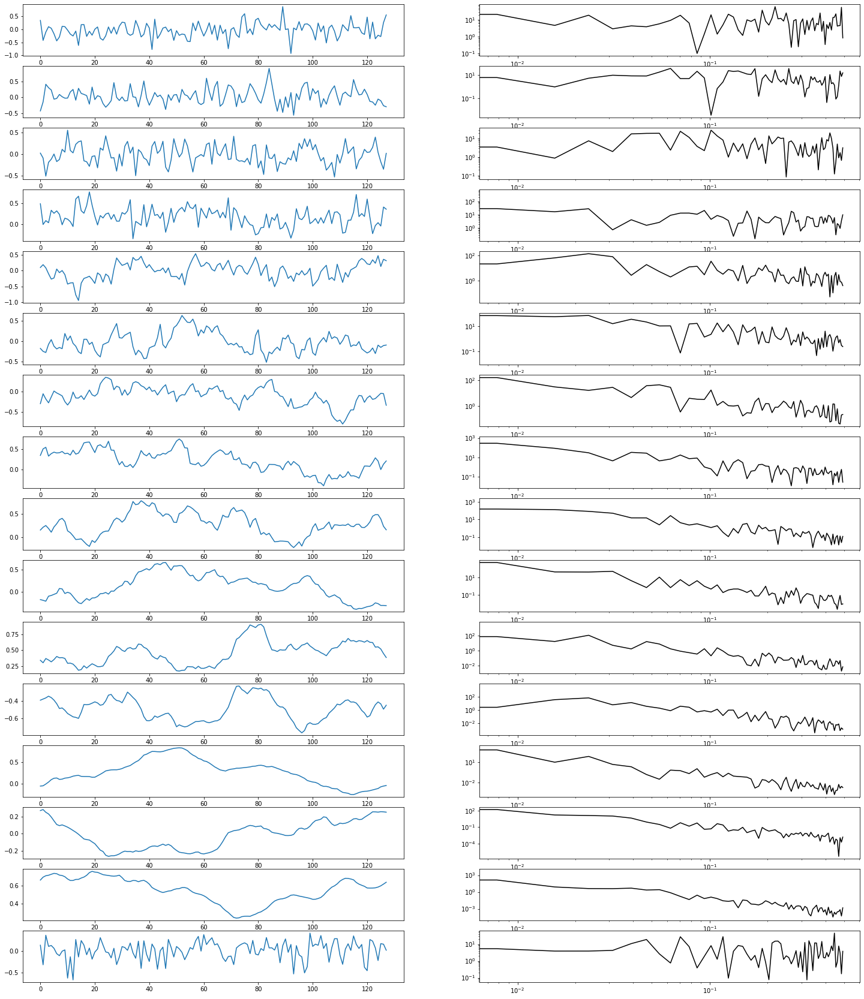

In [266]:
plt.figure(figsize=(25,30))
for i in range(16):
   plt.subplot(16,2,2*i+1)
   plt.plot(df_data_all['image'][i][15])
   plt.subplot(16,2,2*i+2)
   plot_psd(df_data_all['image'][i][15])
  
   #plt.ylabel(df_data_all['class'][i])

### Ploting Data 🗓️

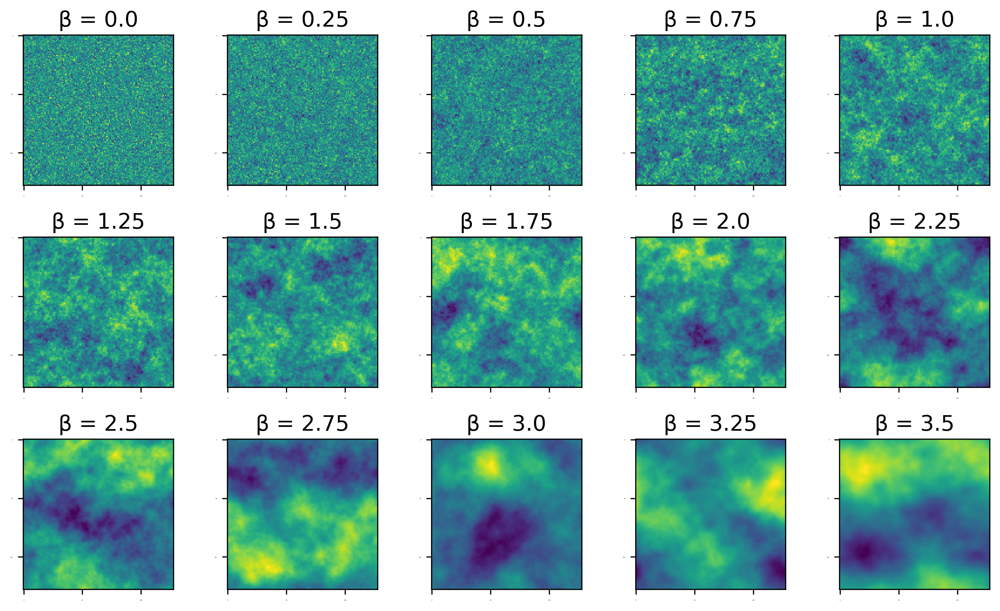

In [17]:
plt.figure(figsize=(10,6),dpi=300)
for i in range(0,15):
  plt.subplot(3,5,i+1)
  plt.xticks(fontsize=0)
  plt.yticks(fontsize=0)
  plt.title('β = '+str(df_data_all['class'][i]),fontsize=15)
  plt.imshow(df_data_all['image'][i])
plt.tight_layout()
plt.savefig('figuras/noise2D.png',bbox_inches='tight')
plt.savefig('figuras/noise2D.pdf',bbox_inches='tight')
plt.show()  


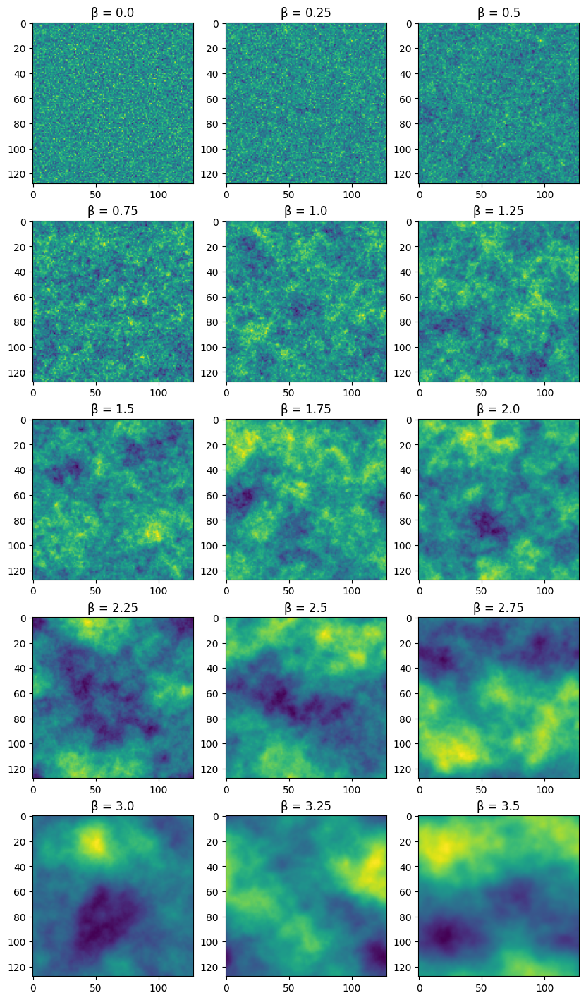

In [268]:
#plt.figure(figsize=(20,10),dpi=50)
plt.figure(figsize=(10,18),dpi=100)
for i in range(0,15):
  plt.subplot(5,3,i+1)
  plt.title('β = '+str(df_data_all['class'][i]))
  plt.imshow(df_data_all['image'][i])
plt.savefig('noise.pdf',bbox_inches='tight')
plt.show()  


In [ ]:
df_data_all.columns

Index(['image', 'class'], dtype='object')

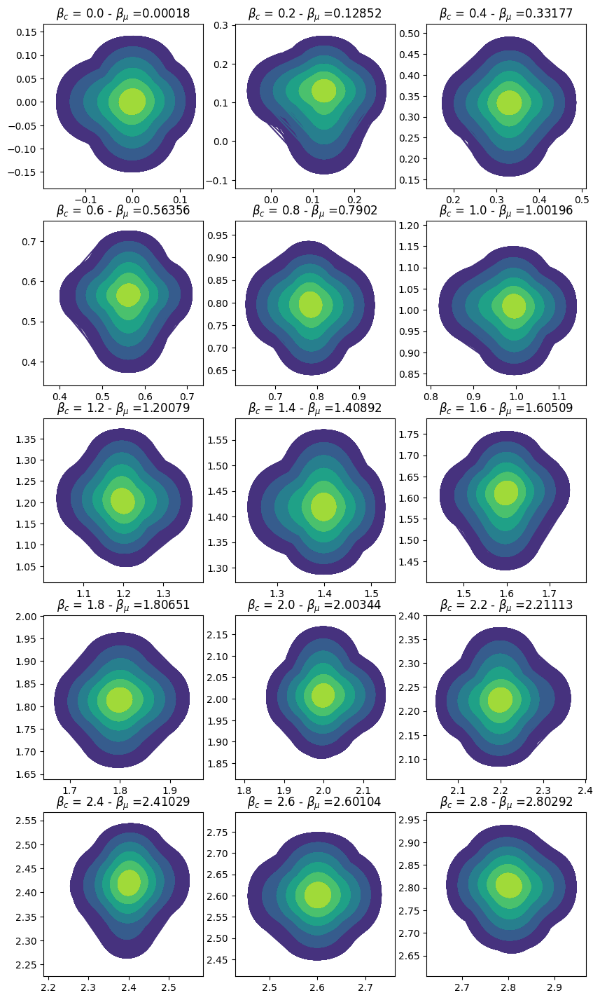

In [ ]:
#plt.figure(figsize=(20,10),dpi=50)
plt.figure(figsize=(10,18),dpi=100)
for i in range(0,15):
  plt.subplot(5,3,i+1)
  plot_psd_conter(df_data_all['image'][i],df_data_all['class'][i])
  # plt.axhline(df_data_all['class'][i],linesytle ='--',color = 'red')
  # plt.axvline(df_data_all['class'][i],linesytle ='--',color = 'red') 
#plt.savefig('noise.pdf',bbox_inches='tight')
plt.show() 

# Using Ordpy
https://doi.org/10.1063/5.0049901

In [4]:
import numpy as np
#if you have not installed the package, you can run the line below instead of importing ordpy.
from ordpy import *
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import seaborn as sns
import colorednoise as cn

import string
import glob
import warnings

#extend notebook
from IPython.core.display import display, HTML
display(HTML("<style>.container {width:99.5% !important;} </style>"))

## Functions

In [7]:
def plot_psd(data,label='PSD',color='k',is_subplot = False,linewidth=1.5):
  '''
  This functions will show the PSD representation for any time series
  '''
  ft = np.fft.fft(data)
  ft = np.real(ft*np.conj(ft))
  freq = np.fft.fftfreq(len(ft))
  seq = np.argsort(freq)
  a,b = np.polyfit(np.log(freq[freq>0.0]),np.log(ft[freq>0.0]),deg=1)
  text = "{} {}f + {}".format(label,np.round(a,3),np.round(b,3))
  #plota o psd
  if is_subplot:
    return freq[seq],ft[seq],a,b
  else:
    return plt.loglog(freq[seq],ft[seq],color=color,label=text,linewidth=linewidth)    

def plot_hc(dx=6,show_legend = True,show_label_x = True,
            show_label_y = True,color = '#202020',size=None):
  hc_max_curve = maximum_complexity_entropy(dx=dx).T
  hc_min_curve = minimum_complexity_entropy(dx=dx, size=719).T

  hmin, cmin = hc_min_curve  #(this variable is defined in the cell above)
  hmax, cmax = hc_max_curve  #(this variable is defined in the cell above)
  plt.plot(hmin, cmin, linewidth=1.5, color=color, zorder=0)
  plt.plot(hmax, cmax, linewidth=1.5, color=color, zorder=0)

  if show_label_x:
    plt.xlabel('Permutation entropy, $H$')
  if show_label_y:
    plt.ylabel('Statistical complexity, $C$')
  if show_legend:
    plt.annotate(f'$d_x = {dx}$', (.5, .2),
                va='center',
                ha='center',
                xycoords='axes fraction',
                fontsize=20,
                bbox={
                    'boxstyle': 'round',
                    'fc': 'white',
                    'alpha': 1,
                    'ec': '#d9d9d9'
                })
#plot_hc(2,False)

In [8]:

def calcBetas(data,horizontal = True):
    betas_1D = []
    if horizontal:
        for line in range(len(data)):
            _,_, a, b = plot_psd(data[line],is_subplot=True)
            betas_1D.append(a)
        return betas_1D
    else:
        for collum in range(len(data)):
            _,_, a, b = plot_psd([linha[collum] for linha in data],is_subplot=True)
            betas_1D.append(a)
        return betas_1D


## Reproducing the original paper

In [16]:

samples1 = 2**15 # = 32768

wn1 = cn.powerlaw_psd_gaussian(0, samples1)
pn1 = cn.powerlaw_psd_gaussian(1, samples1)
tn1 = cn.powerlaw_psd_gaussian(5/3, samples1)
rn1 = cn.powerlaw_psd_gaussian(2, samples1)


dx = 6

hc_wn1 = np.mean([complexity_entropy(wn1, dx=dx) for _ in range(10)],axis=0)
hc_pn1 = np.mean([complexity_entropy(pn1, dx=dx) for _ in range(10)],axis=0)
hc_tn1 = np.mean([complexity_entropy(tn1, dx=dx) for _ in range(10)],axis=0)
hc_rn1 = np.mean([complexity_entropy(rn1, dx=dx) for _ in range(10)],axis=0)



In [58]:
import matplotlib.pyplot as plt

# Dados
fontsize = 12
noises1 = [wn1, pn1, tn1, rn1]
hcs1 = [hc_wn1, hc_pn1, hc_tn1, hc_rn1]
colors = ["black", "magenta", "blue", "red"]
letters = ["(a)", "(b)", "(c)", "(d)"]
labels = ['$\\beta = 0$   ', 
          '$\\beta = 1$   ', 
          '$\\beta = 5/3$ ', 
          '$\\beta = 2$   ']
markers = ['1', '2', '4', '3']


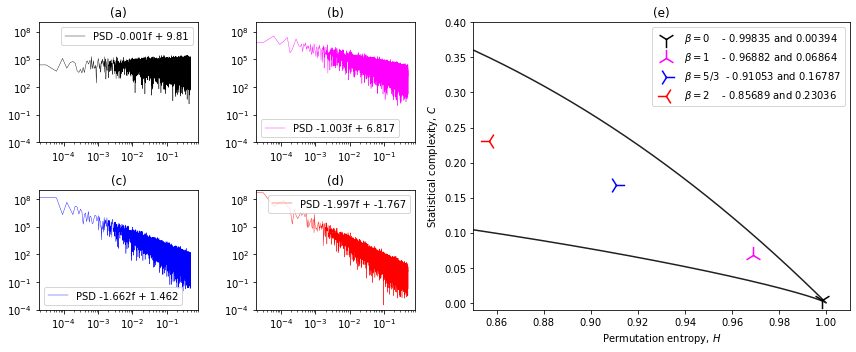

In [260]:

plt.figure(figsize=(12, 5))

# Plotando séries temporais
positions = [(0, 0), (0, 1), (1, 0), (1, 1)]
for i in range(4):
    plt.subplot2grid((2, 4), positions[i])
    plot_psd(noises1[i], color=colors[i],linewidth=0.4)
    plt.title(letters[i], fontsize=fontsize)
    plt.ylim(1e-4, 1e9)
    plt.legend()

# Plotando diagrama HC
plt.subplot2grid((2, 4), (0, 2), rowspan=2, colspan=2)
plt.subplots_adjust(hspace=0.4)
plot_hc(show_legend=False)

for i in range(4):
    plt.scatter((hcs1[i][0]), (hcs1[i][1]), label=f"{labels[i]} - {round((hcs1[i][0]), 5)} and {round((hcs1[i][1]), 5)}", color=colors[i], marker=markers[i], s=300)

plt.xlim(0.85, 1.01)
plt.ylim(-0.01, 0.4)
plt.title("(e)", fontsize=fontsize)
plt.legend()
# plt.suptitle(f'Permutation entropy and Statistical Complexty')
plt.tight_layout()
plt.savefig('figuras/PSD_HC.pdf', dpi=300)
plt.savefig('figuras/PSD_HC.png', dpi=100)


## 1D - Study the impact of $d_x$ and the `len(series)`

In [235]:
# wn, pn, rn = [],[],[]
# for i in range(0,7):
#     wn.append(cn.powerlaw_psd_gaussian(0, 2**(2*i+4)))
#     pn.append(cn.powerlaw_psd_gaussian(1, 2**(2*i+4)))
#     rn.append(cn.powerlaw_psd_gaussian(2, 2**(2*i+4)))
# plt.figure(figsize=(20,20))
# for i in range(len(wn)):
#   plt.subplot(len(wn),3,3*i+1)
  
#   plt.plot(wn[i])
#   plt.subplot(len(pn),3,3*i+2)
#   plt.plot(pn[i])
#   plt.subplot(len(rn),3,3*i+3)
#   plt.plot(rn[i])
  
  

In [66]:
markers = ['o','s','^','v','<','>','p','*','h','H','D','d','P','X','x','|','_',',','.','1','2','3','4','8','+',' ']
W = []
P = []
T = []
R = []
for dx in range(0,8):
  #plt.subplot(8,1,dx+1)
  wn = []
  pn = []
  tn = []
  rn = []
  hc_wn = []
  hc_pn = []
  hc_tn = []
  hc_rn = []
  for i in range(0,7):
    wn.append(cn.powerlaw_psd_gaussian(0,   2**(2*i+4)))
    pn.append(cn.powerlaw_psd_gaussian(1,   2**(2*i+4)))
    tn.append(cn.powerlaw_psd_gaussian(5/3, 2**(2*i+4)))
    rn.append(cn.powerlaw_psd_gaussian(2,  2**(2*i+4)))
    hc_wn.append(np.mean([complexity_entropy(wn[i], dx=dx+2) for _ in range(10)],axis=0))
    hc_pn.append(np.mean([complexity_entropy(pn[i], dx=dx+2) for _ in range(10)],axis=0))  
    hc_tn.append(np.mean([complexity_entropy(tn[i], dx=dx+2) for _ in range(10)],axis=0))
    hc_rn.append(np.mean([complexity_entropy(rn[i], dx=dx+2) for _ in range(10)],axis=0))
    
    
  W.append(hc_wn)
  P.append(hc_pn)
  T.append(hc_tn)
  R.append(hc_rn)

In [14]:
# big_wn = cNoise.cNoise(0,(2**15,2**15),maxCorrections=100,maxAvgError=0.001, eta=0.05)
# big_pn = cNoise.cNoise(1,(2**15,2**15),maxCorrections=100,maxAvgError=0.001, eta=0.05)
# big_rn = cNoise.cNoise(2,(2**15,2**15),maxCorrections=100,maxAvgError=0.001, eta=0.05)

<ipython-input-257-fa77a45d60c9>:18: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout(pad=0.5, rect=[0, 0, 0, 1.42])


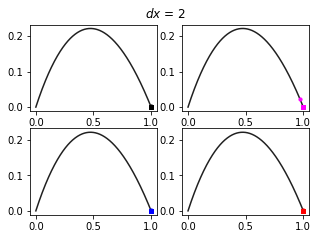

In [257]:
import matplotlib.pyplot as plt

noises = [W, P, T, R]


for dx in range(6):
    plt.figure(figsize=(5, 3.5))
    plt.suptitle(f'$dx$ = {dx+2}', y=.95)
    for beta in range(len(betas)):
        plt.subplot(2, 2, 1 + beta)
        # plt.title(letters[beta])
        plot_hc((dx+2), show_label_y=False, show_label_x=False, show_legend=False)
        for i in range(len(wn)):
            plt.scatter(noises[beta][dx][i][0], noises[beta][dx][i][1], label=f"{int(np.log2(len(pn[i])))}", color=colors[beta], marker=markers[i], s=10)

    # Ajustando a legenda para ficar abaixo das figuras
    if dx == 5: plt.legend(bbox_to_anchor=(-0.2, -0.75), loc='lower center', ncol=4, fancybox=True, shadow=True)

    plt.tight_layout(pad=0.5, rect=[0, 0, 0, 1.42])

    plt.savefig(f'figuras/HC_PSD_{dx+2}.png', dpi=100, bbox_inches='tight')
    plt.savefig(f'figuras/HC_PSD_{dx+2}.pdf', dpi=300, bbox_inches='tight')
    # plt.show()


## 2D Bidimensional Case

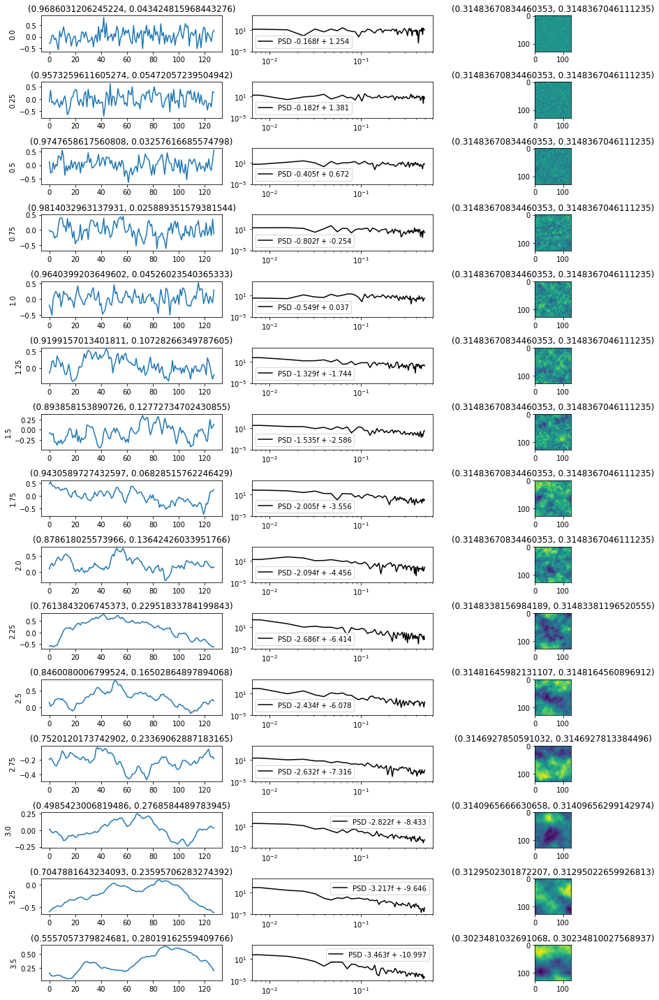

In [12]:
plt.figure(figsize = (13,20))

chosed_len = 15

dx = 4

for i in range(chosed_len):
   #Time series 
   plt.subplot(chosed_len,3,3*i+1)
   plt.plot(df_data_all['image'][i][0])
   plt.ylabel(df_data_all['class'][i])
   plt.title(str(complexity_entropy(df_data_all['image'][i][15], dx=dx)))

   #PSD
   plt.subplot(chosed_len,3,3*i+2)
   plot_psd(df_data_all['image'][i][0])
   plt.ylim(1e-5,1e5)
   plt.legend()
   
   #Figure
   plt.subplot(chosed_len,3,3*i+3)
   #plt.title('β = '+str(df_data_all['class'][i]))
   plt.imshow(df_data_all['image'][i])   
   plt.title(str(complexity_entropy(df_data_all['image'][i], dx=dx, dy=dx)))
plt.tight_layout()

In [230]:
_, _, beta_coll, b = plot_psd([linha[collum] for linha in data],is_subplot=True)

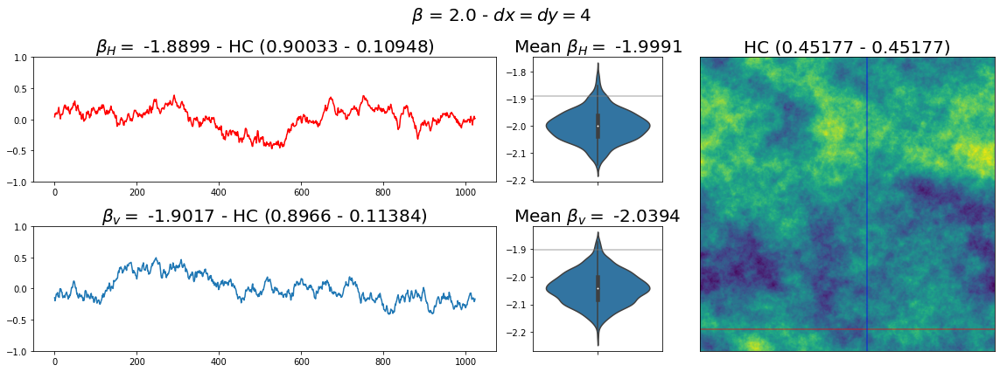

In [57]:
dxdy = 4
beta = 2
for image in range(10):
    print(complexity_entropy(df_data_all[df_data_all['class'] == beta].reset_index(drop=True).image[image], dx=dxdy, dy=dxdy))
    

(0.31483670834460353, 0.3148367046111235)
(0.31483670834460353, 0.3148367046111235)
(0.31483670834460353, 0.3148367046111235)
(0.31483670834460353, 0.3148367046111235)
(0.31483670834460353, 0.3148367046111235)
(0.31483670834460353, 0.3148367046111235)
(0.31483670834460353, 0.3148367046111235)
(0.31483670834460353, 0.3148367046111235)
(0.31483670834460353, 0.3148367046111235)
(0.31483670834460353, 0.3148367046111235)


In [54]:
hc_2D_wn3 = []
hc_2D_pn3 = []
hc_2D_tn3 = []
hc_2D_rn3 = []
dx = [2,3,4,6]
for i in range(len(dx)):
    hc_2D_wn3.append(np.array(complexity_entropy(df_data_all['image'][0], dx=dx[i], dy=dx[i]) ))# for _ in range(10)],axis=0))
    hc_2D_pn3.append(np.array(complexity_entropy(df_data_all['image'][5], dx=dx[i], dy=dx[i]) ))# for _ in range(10)],axis=0))
    hc_2D_tn3.append(np.array(complexity_entropy(df_data_all['image'][7], dx=dx[i], dy=dx[i]) ))# for _ in range(10)],axis=0))
    hc_2D_rn3.append(np.array(complexity_entropy(df_data_all['image'][10], dx=dx[i], dy=dx[i])))# for _ in range(10)],axis=0))

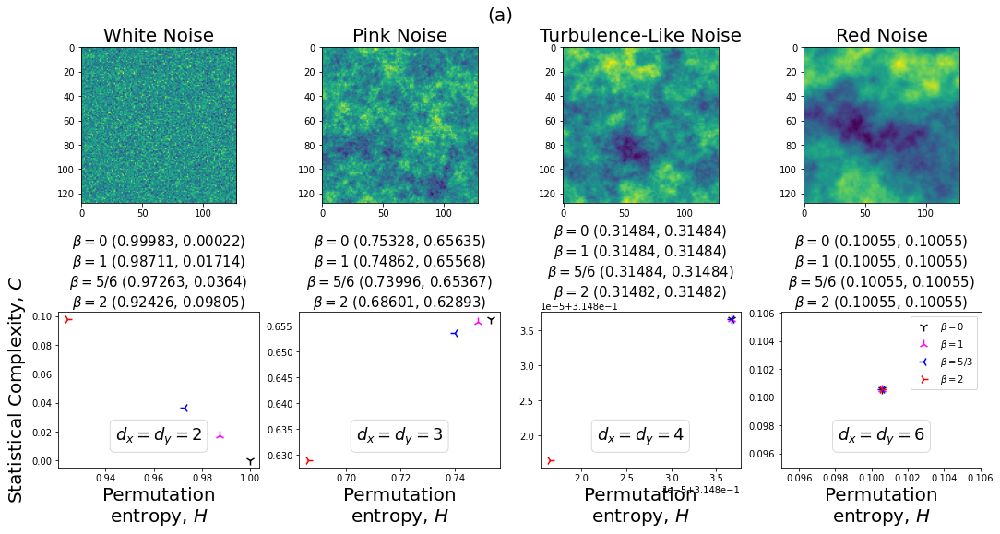

In [123]:
titles = ['White Noise', 'Pink Noise', 'Turbulence-Like Noise', 'Red Noise']
dx = [2,3,4,6]

images_ids = [0,5,8,10]
fontsize = 20
plt.figure(figsize=(15,8))

plt.suptitle('(a)',y = .99,fontsize=fontsize)

for i in range(4):
    plt.subplot(2,4,i+1)
    plt.imshow(df_data_all['image'][images_ids[i]])
    plt.title(titles[i],fontsize=fontsize)


for i in range(len(dx)):
    #Set a vertical space beteween the plots
    plt.subplot(2,4,i+5)
    plt.subplots_adjust(hspace=0.46)
    plt.scatter((hc_2D_wn3[i][0]),(hc_2D_wn3[i][1]),label = '$\\beta = 0$  ', color = 'k', marker='1',s=100)
    plt.scatter((hc_2D_pn3[i][0]),(hc_2D_pn3[i][1]),label = '$\\beta = 1$  ', color = 'magenta', marker='2',s=100)
    plt.scatter((hc_2D_tn3[i][0]),(hc_2D_tn3[i][1]),label = '$\\beta = 5/3$', color = 'blue', marker='3',s=100)
    plt.scatter((hc_2D_rn3[i][0]),(hc_2D_rn3[i][1]),label = '$\\beta = 2$  ', color = 'r', marker='4',s=100)
    plt.title(f'$\\beta = 0 $ {round((hc_2D_wn3[i][0]),5),round((hc_2D_wn3[i][1]),5)}\n$\\beta = 1 $ {round((hc_2D_pn3[i][0]),5),round((hc_2D_pn3[i][1]),5)}\n$\\beta = 5/6 $ {round((hc_2D_tn3[i][0]),5),round((hc_2D_tn3[i][1]),5)}\n$\\beta = 2 $ {round((hc_2D_rn3[i][0]),5),round((hc_2D_rn3[i][1]),5)}',fontsize=fontsize-5)
    if i == 0:
        plt.ylabel('Statistical Complexity, $C$',fontsize=fontsize)
    
    plt.xlabel('Permutation\nentropy, $H$',fontsize=fontsize)  
    plt.annotate(f'$d_x = d_y = {dx[i]}$', (.5, .2),
            va='center',
            ha='center',
            xycoords='axes fraction',
            fontsize=18,
            bbox={
                'boxstyle': 'round',
                'fc': 'white',
                'alpha': 1,
                'ec': '#d9d9d9'
            })      

plt.legend()
# plt.tight_layout()
plt.tight_layout(pad=0.5)#, rect=[0, 0, 0, 1.42])

plt.savefig('figuras/HC_PSD_2D_a.pdf', dpi=300)
plt.savefig('figuras/HC_PSD_2D_a.png', dpi=100)


In [90]:
hc_2D_wn2 = []
hc_2D_pn2 = []
hc_2D_tn2 = []
hc_2D_rn2 = []
dx = [2,3,4,6]
for i in range(len(dx)):
    hc_2D_wn2.append(np.array(complexity_entropy(df_data_all2['image'][0], dx=dx[i], dy=dx[i]) ))# for _ in range(10)],axis=0))
    hc_2D_pn2.append(np.array(complexity_entropy(df_data_all2['image'][5], dx=dx[i], dy=dx[i]) ))# for _ in range(10)],axis=0))
    hc_2D_tn2.append(np.array(complexity_entropy(df_data_all2['image'][8], dx=dx[i], dy=dx[i]) ))# for _ in range(10)],axis=0))
    hc_2D_rn2.append(np.array(complexity_entropy(df_data_all2['image'][10], dx=dx[i], dy=dx[i])))# for _ in range(10)],axis=0))

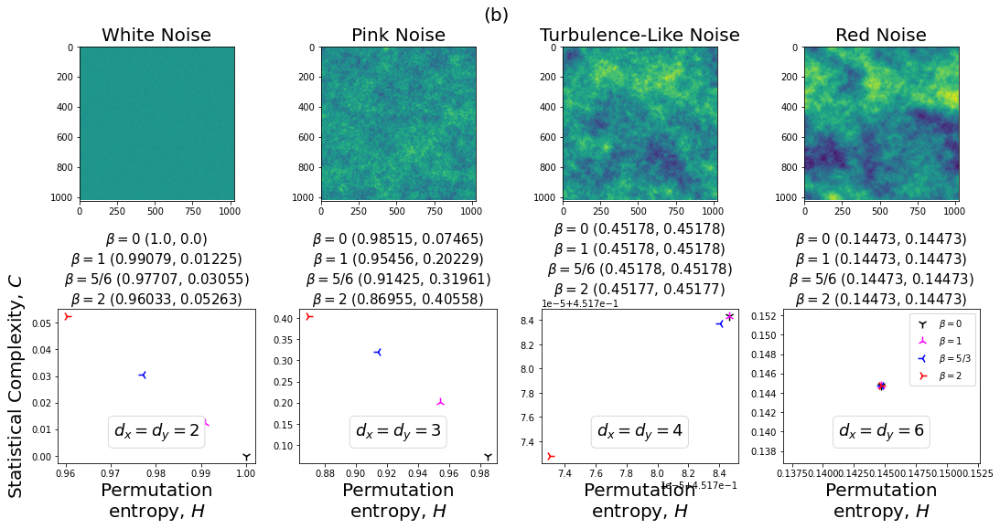

In [124]:
titles = ['White Noise', 'Pink Noise', 'Turbulence-Like Noise', 'Red Noise']
dx = [2,3,4,6]

images_ids = [0,5,8,10]
fontsize = 20
plt.figure(figsize=(15,8))

plt.suptitle('(b)',y = .99,fontsize=fontsize)

for i in range(4):
    plt.subplot(2,4,i+1)
    plt.imshow(df_data_all2['image'][images_ids[i]])
    plt.title(titles[i],fontsize=fontsize)


for i in range(len(dx)):
    #Set a vertical space beteween the plots
    plt.subplot(2,4,i+5)
    plt.subplots_adjust(hspace=0.46)
    plt.scatter((hc_2D_wn2[i][0]),(hc_2D_wn2[i][1]),label = '$\\beta = 0$  ', color = 'k', marker='1',s=100)
    plt.scatter((hc_2D_pn2[i][0]),(hc_2D_pn2[i][1]),label = '$\\beta = 1$  ', color = 'magenta', marker='2',s=100)
    plt.scatter((hc_2D_tn2[i][0]),(hc_2D_tn2[i][1]),label = '$\\beta = 5/3$', color = 'blue', marker='3',s=100)
    plt.scatter((hc_2D_rn2[i][0]),(hc_2D_rn2[i][1]),label = '$\\beta = 2$  ', color = 'r', marker='4',s=100)
    plt.title(f'$\\beta = 0 $ {round((hc_2D_wn2[i][0]),5),round((hc_2D_wn2[i][1]),5)}\n$\\beta = 1 $ {round((hc_2D_pn2[i][0]),5),round((hc_2D_pn2[i][1]),5)}\n$\\beta = 5/6 $ {round((hc_2D_tn2[i][0]),5),round((hc_2D_tn2[i][1]),5)}\n$\\beta = 2 $ {round((hc_2D_rn2[i][0]),5),round((hc_2D_rn2[i][1]),5)}',fontsize=fontsize-5)
    if i == 0:
        plt.ylabel('Statistical Complexity, $C$',fontsize=fontsize)
    
    plt.xlabel('Permutation\nentropy, $H$',fontsize=fontsize)  
    plt.annotate(f'$d_x = d_y = {dx[i]}$', (.5, .2),
            va='center',
            ha='center',
            xycoords='axes fraction',
            fontsize=18,
            bbox={
                'boxstyle': 'round',
                'fc': 'white',
                'alpha': 1,
                'ec': '#d9d9d9'
            })      

plt.legend()
# plt.tight_layout()
plt.tight_layout(pad=0.5)#, rect=[0, 0, 0, 1.42])

plt.savefig('figuras/HC_PSD_2D_b.pdf', dpi=300)
plt.savefig('figuras/HC_PSD_2D_b.png', dpi=100)


## 1D and 2D - Conbined Analyses

In [58]:
import random
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import numpy as np
import seaborn as sns

#External Paramenters
images_ids = [0,4,7,8] # [0,5,8,10]
beta_violin_color = ['gray', 'magenta', 'blue', 'red']
dxdy = 6
beta = 2
image_id = images_ids[beta]
beta_class = df_data_all['class'][image_id]
data = df_data_all['image'][image_id]
hc_2D = complexity_entropy(data, dx=dxdy, dy=dxdy)

betas_1D_line = calcBetas(data, horizontal=True)
betas_1D_colu = calcBetas(data, horizontal=False)

hc_lines, hc_colus = [], []

# Calculate complexity entropy for each row
for line in range(len(data)):
    hc_lines.append(complexity_entropy(data[line], dx=dxdy))

# Calculate complexity entropy for each column
for col in range(len(data[0])):
    column_data = [data[row][col] for row in range(len(data))]
    hc_colus.append(complexity_entropy(column_data, dx=dxdy))
hc_lines,hc_colus = np.array(hc_lines), np.array(hc_colus)        

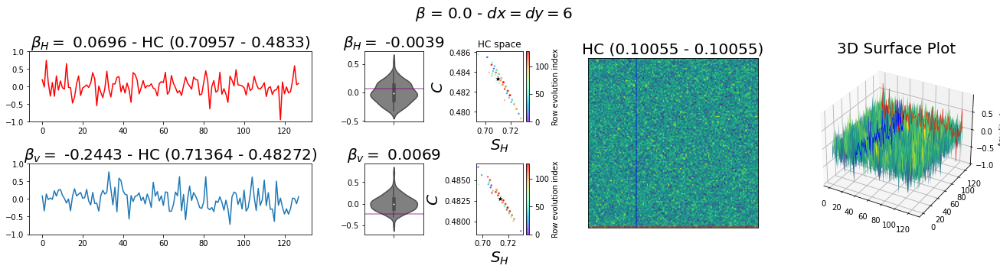

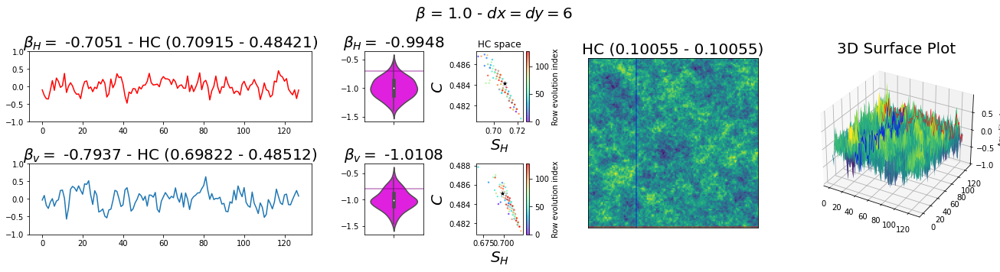

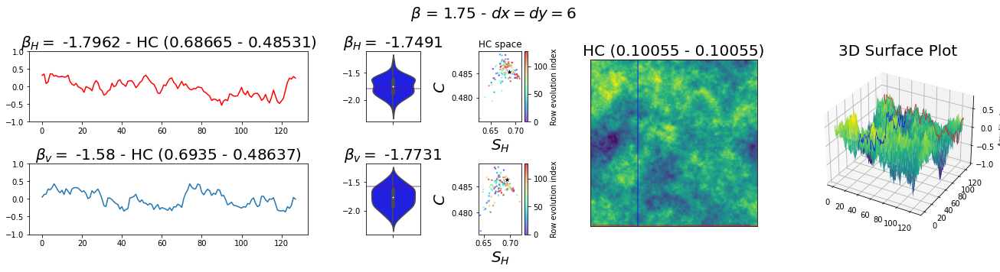

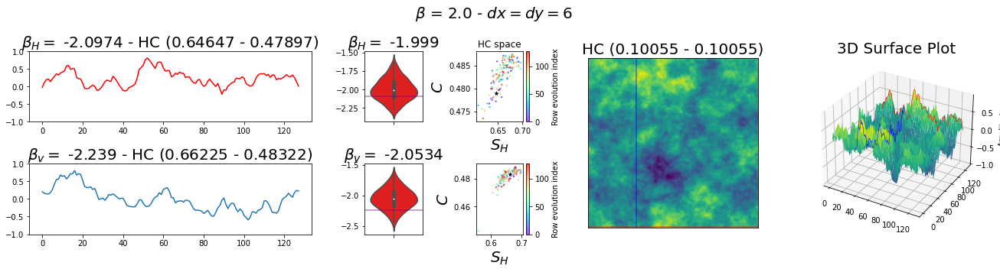

In [62]:
#Internal Paramentes
# line = random.randint(0, len(df_data_all['image'][image_id]) - 1)
# collum = random.randint(0, len(df_data_all['image'][image_id]) - 1)

# betas = [0,1,2,3]

# for beta in betas:

# #External Paramenters
# images_ids = [0,4,7,8] # [0,5,8,10]
# beta_violin_color = ['gray', 'magenta', 'blue', 'red']
# dxdy = 6
# # beta = 2
# image_id = images_ids[beta]
# beta_class = df_data_all['class'][image_id]
# data = df_data_all['image'][image_id]
# hc_2D = complexity_entropy(data, dx=dxdy, dy=dxdy)

# betas_1D_line = calcBetas(data, horizontal=True)
# betas_1D_colu = calcBetas(data, horizontal=False)

# hc_lines, hc_colus = [], []

# # Calculate complexity entropy for each row
# for line in range(len(data)):
#     hc_lines.append(complexity_entropy(data[line], dx=dxdy))

# # Calculate complexity entropy for each column
# for col in range(len(data[0])):
#     column_data = [data[row][col] for row in range(len(data))]
#     hc_colus.append(complexity_entropy(column_data, dx=dxdy))
# hc_lines,hc_colus = np.array(hc_lines), np.array(hc_colus)     



_, _, beta_line, _ = plot_psd(data[line], is_subplot=True)
_, _, beta_coll, _ = plot_psd([linha[collum] for linha in data],is_subplot=True)

#plot
fontsize = 20

plt.figure(figsize=(18, 5))#, dpi=100)

gs = gridspec.GridSpec(2, 9)

plt.suptitle(f"$\\beta$ = {beta_class} - $dx = dy = {dxdy}$", fontsize=fontsize)

########################## H O R I Z O N T A L ################################
#Horizontal Line
ax1 = plt.subplot(gs[0, 0:3])
ax1.plot(data[line], color='red')
ax1.set_title(f"$\\beta_H =$ {np.round(beta_line, 4)} - HC ({np.round(hc_lines[line][0], 5)} - {np.round(hc_lines[line][1], 5)})", fontsize=fontsize)
ax1.set_ylim(-1,1)

#Horizontal Violin 
ax2 = plt.subplot(gs[0, 3])
sns.violinplot(y=betas_1D_line, ax=ax2,color = beta_violin_color[beta])
ax2.axhline(beta_line, color='purple', alpha=0.5)#,lineStyle='--')
ax2.set_title(f"$\\beta_H =$ {np.round(np.mean(betas_1D_line), 4)}",fontsize=fontsize)

#Horizontal Scatter
ax3 = plt.subplot(gs[0, 4])
indices = np.arange(hc_lines.shape[0])
norm = plt.Normalize(indices.min(), indices.max())
ax3.set_title("HC space")#f"{np.round(hc_lines[line][0], 5)} - {np.round(hc_lines[line][1], 5)}",fontsize=fontsize)
ax3.set_xlabel('$S_H$',fontsize=fontsize)
ax3.set_ylabel('$C$',fontsize=fontsize)
sc = ax3.scatter(hc_lines[:, 0], hc_lines[:, 1], c=indices, cmap='rainbow', norm=norm, alpha=0.7, s=2)
cbar = plt.colorbar(sc, ax=ax3)
cbar.set_label('Row evolution index')
ax3.scatter(hc_lines[line, 0], hc_lines[line, 1], alpha=1, edgecolors='w', s=100, c='k', marker='*')

########################### V E R T I C A L ####################################
#Vertical Line
ax4 = plt.subplot(gs[1, 0:3])
ax4.plot([linha[collum] for linha in data])  
ax4.set_title(f"$\\beta_v =$ {np.round(beta_coll, 4)} - HC ({np.round(hc_colus[collum][0], 5)} - {np.round(hc_colus[collum][1], 5)})", fontsize=fontsize)
ax4.set_ylim(-1,1)

#Vertical violin
ax5 = plt.subplot(gs[1, 3])
sns.violinplot(y=betas_1D_colu, ax=ax5,color = beta_violin_color[beta])
ax5.axhline(beta_coll, color='purple', alpha=0.5)#,lineStyle='--')
ax5.set_title(f"$\\beta_v =$ {np.round(np.mean(betas_1D_colu), 4)}",fontsize=fontsize)

#Vertical Scatter
ax6 = plt.subplot(gs[1, 4])
indices = np.arange(hc_colus.shape[0])
# ax6.set_title(f"{np.round(hc_colus[collum][0], 5)} - {np.round(hc_colus[collum][1], 5)}",fontsize=fontsize)
ax6.set_xlabel('$S_H$',fontsize=fontsize)
ax6.set_ylabel('$C$',fontsize=fontsize)
norm = plt.Normalize(indices.min(), indices.max())
sc = ax6.scatter(hc_colus[:, 0], hc_colus[:, 1], c=indices, cmap='rainbow', norm=norm, alpha=0.7, s=2)
cbar = plt.colorbar(sc, ax=ax6)
cbar.set_label('Row evolution index')
ax6.scatter(hc_colus[collum, 0], hc_colus[collum, 1], alpha=1, edgecolors='w', s=100, c='k', marker='*')

############################## IMAGE ###########################################
ax7 = plt.subplot(gs[:, 5:7])
ax7.imshow(data)
ax7.set_xticks([])
ax7.set_yticks([])
ax7.set_title(f"HC ({np.round(hc_2D[0], 5)} - {np.round(hc_2D[1], 5)})",fontsize=fontsize)
ax7.axhline(line, color='red', alpha=0.5)
ax7.axvline(collum, color='blue', alpha=0.5)


############################## 3D IMAGE ###########################################

ax8 = plt.subplot(gs[:, 7:9], projection='3d')

# Create a meshgrid
x = np.arange(data.shape[1])
y = np.arange(data.shape[0])
X, Y = np.meshgrid(x, y)
ax8.plot_surface(X, Y, data, cmap='viridis')
ax8.plot(x, line * np.ones_like(x), data[line, :], color='r', lw=0.5,zorder=10)
ax8.plot(collum * np.ones_like(y), y, data[:, collum], color='b', lw=0.5,zorder = 10)
ax8.set_zlabel('Amplitude')
ax8.set_title(f'3D Surface Plot',fontsize=fontsize)

plt.tight_layout()
plt.savefig(f'figuras/HC_PSD_1Dand2D_{image_id}_{dxdy}_{line}x{collum}.png')#, dpi=300)
plt.savefig(f'figuras/HC_PSD_1Dand2D_{image_id}_{dxdy}_{line}x{collum}.pdf')#, dpi=300)
plt.show()


### 3D View

In [37]:

# Create the 3D surface plot
surface = go.Surface(z=data, x=X, y=Y, colorscale='Viridis')

# Plot a single row

row_line = go.Scatter3d(
    x=x,
    y=line * np.ones_like(x),
    z=data[line, :],
    mode='lines',
    line=dict(color='red', width=4),
    name='Row Line'
)

# Plot a single column
column_line = go.Scatter3d(
    x=collum * np.ones_like(y),
    y=y,
    z=data[:, collum],
    mode='lines',
    line=dict(color='blue', width=4),
    name='Column Line'
)

# Combine the plots
fig = go.Figure(data=[surface, row_line, column_line])

# Set labels
fig.update_layout(
    scene=dict(
        xaxis_title='X',
        yaxis_title='Y',
        zaxis_title='Data'
    ),
    title='3D Surface with Row and Column Lines'
)

fig.show()

In [63]:
import numpy as np
import plotly.graph_objects as go

# Create a meshgrid
x = np.arange(data.shape[1])
y = np.arange(data.shape[0])
X, Y = np.meshgrid(x, y)

# Create the initial 3D surface plot
surface = go.Surface(z=data, x=X, y=Y, colorscale='Viridis')

# Function to update row line
def update_row_line(row_index):
    return go.Scatter3d(
        x=x,
        y=row_index * np.ones_like(x),
        z=data[row_index, :],
        mode='lines',
        line=dict(color='red', width=4),
        name='Row Line'
    )

# Function to update column line
def update_column_line(column_index):
    return go.Scatter3d(
        x=column_index * np.ones_like(y),
        y=y,
        z=data[:, column_index],
        mode='lines',
        line=dict(color='blue', width=4),
        name='Column Line'
    )

# Initial row and column indices
row_index = 50
column_index = 50

# Create the initial row and column lines
row_line = update_row_line(row_index)
column_line = update_column_line(column_index)

# Combine the plots
fig = go.Figure(data=[surface, row_line, column_line])

# Set labels
fig.update_layout(
    scene=dict(
        xaxis_title='X',
        yaxis_title='Y',
        zaxis_title='Data'
    ),
    title='3D Surface with Row and Column Lines'
)

# Create frames for row lines
frames_row = [go.Frame(data=[update_row_line(i), column_line], name=f'row_{i}') for i in range(data.shape[0])]
# Create frames for column lines
frames_column = [go.Frame(data=[row_line, update_column_line(i)], name=f'column_{i}') for i in range(data.shape[1])]

fig.frames = frames_row + frames_column

# Add sliders
fig.update_layout(
    sliders=[
        {
            "steps": [
                {
                    "args": [
                        [f'row_{i}'],
                        {
                            "frame": {"duration": 0, "redraw": True},
                            "mode": "immediate",
                            "transition": {"duration": 0},
                        },
                    ],
                    "label": str(i),
                    "method": "animate",
                }
                for i in range(data.shape[0])
            ],
            "active": row_index,
            "currentvalue": {"prefix": "Row: "},
            "pad": {"b": 10},
            "x": 0.1,
            "xanchor": "left",
            "y": 0,
            "yanchor": "top"
        },
        {
            "steps": [
                {
                    "args": [
                        [f'column_{i}'],
                        {
                            "frame": {"duration": 0, "redraw": True},
                            "mode": "immediate",
                            "transition": {"duration": 0},
                        },
                    ],
                    "label": str(i),
                    "method": "animate",
                }
                for i in range(data.shape[1])
            ],
            "active": column_index,
            "currentvalue": {"prefix": "Column: "},
            "pad": {"t": 50},
            "x": 0.1,
            "xanchor": "left",
            "y": 0,
            "yanchor": "top"
        }
    ]
)

fig.show()


In [444]:
import random
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import numpy as np
import seaborn as sns

#External Paramenters
images_ids = [0,5,8,10]
beta_violin_color = ['gray', 'magenta', 'blue', 'red']
dxdy = 4
beta = 2
image_id = images_ids[beta]

#Internal Paramentes
line = random.randint(0, len(df_data_all2['image'][images_ids[beta]]) - 1)
collum = random.randint(0, len(df_data_all2['image'][images_ids[beta]]) - 1)

for line in range(len(df_data_all2['image'][images_ids[beta]])):
    _, _, beta_line, _ = plot_psd(data[line], is_subplot=True)
    _, _, beta_coll, _ = plot_psd([linha[collum] for linha in data],is_subplot=True)
    collum = line
    #plot
    fontsize = 20

    plt.figure(figsize=(18, 6))#, dpi=100)

    gs = gridspec.GridSpec(2, 7)

    plt.suptitle(f"$\\beta$ = {beta_class} - $dx = dy = {dxdy}$", fontsize=fontsize)

    #Horizontal Line
    ax1 = plt.subplot(gs[0, 0:3])
    ax1.set_title(f"Row {line}",fontsize=fontsize)
    ax1.plot(data[line], color='red')
    ax1.set_ylim(-1,1)

    #Horizontal Violin 
    ax2 = plt.subplot(gs[0, 3])

    sns.violinplot(y=betas_1D_line, ax=ax2,color = beta_violin_color[beta])
    ax2.axhline(beta_line, color='purple', alpha=0.5)#,lineStyle='--')
    ax2.set_title(f"$\\beta_H =$ {np.round(np.mean(betas_1D_line), 4)}",fontsize=fontsize)

    #Horizontal Scatter
    ax3 = plt.subplot(gs[0, 4])
    ax3 = plt.subplot(gs[0, 4])
    indices = np.arange(hc_lines.shape[0])
    ax3.set_title(f"{np.round(hc_lines[line][0], 5)} - {np.round(hc_lines[line][1], 5)}",fontsize=fontsize)
    ax3.set_xlabel('$S_H$',fontsize=fontsize)
    ax3.set_ylabel('$C$',fontsize=fontsize)
    norm = plt.Normalize(indices.min(), indices.max())
    sc = ax3.scatter(hc_lines[:, 0], hc_lines[:, 1], c=indices, cmap='rainbow', norm=norm, alpha=0.7, s=2)
    cbar = plt.colorbar(sc, ax=ax3)
    cbar.set_label('Row evolution index')
    ax3.scatter(hc_lines[line, 0], hc_lines[line, 1], alpha=1, edgecolors='w', s=100, c='k', marker='*')

    ########################### V E R T I C A L ####################################
    #Vertical Line
    ax4 = plt.subplot(gs[1, 0:3])
    ax4.plot([linha[collum] for linha in data])
    ax4.set_title(f"Collumn {collum}",fontsize=fontsize)    
    ax4.set_ylim(-1,1)

    #Vertical violin
    ax5 = plt.subplot(gs[1, 3])
    sns.violinplot(y=betas_1D_colu, ax=ax5,color = beta_violin_color[beta])
    ax5.axhline(beta_coll, color='purple', alpha=0.5)#,lineStyle='--')
    ax5.set_title(f"$\\beta_v =$ {np.round(np.mean(betas_1D_colu), 4)}",fontsize=fontsize)

    #Vertical Scatter
    ax6 = plt.subplot(gs[1, 4])
    indices = np.arange(hc_colus.shape[0])
    ax6.set_title(f"{np.round(hc_colus[collum][0], 5)} - {np.round(hc_colus[collum][1], 5)}",fontsize=fontsize)
    ax6.set_xlabel('$S_H$',fontsize=fontsize)
    ax6.set_ylabel('$C$',fontsize=fontsize)
    norm = plt.Normalize(indices.min(), indices.max())
    sc = ax6.scatter(hc_colus[:, 0], hc_colus[:, 1], c=indices, cmap='rainbow', norm=norm, alpha=0.7, s=2)
    cbar = plt.colorbar(sc, ax=ax6)
    cbar.set_label('Row evolution index')
    ax6.scatter(hc_colus[collum, 0], hc_colus[collum, 1], alpha=1, edgecolors='w', s=100, c='k', marker='*')

    ############################## IMAGE ###########################################
    ax7 = plt.subplot(gs[:, 5:7])
    ax7.imshow(data)
    ax7.set_xticks([])
    ax7.set_yticks([])
    ax7.set_title(f"HC ({np.round(hc_2D[0], 5)} - {np.round(hc_2D[1], 5)})",fontsize=fontsize)
    ax7.axhline(line, color='red', alpha=0.5)
    ax7.axvline(collum, color='blue', alpha=0.5)

    plt.tight_layout()
    plt.savefig(f'figuras/1Dand2D_analysis/HC_PSD_1Dand2D_{image_id}_{dxdy}_{line}x{collum}.png')#, dpi=300)
    plt.show()


IndexError: index 218 is out of bounds for axis 0 with size 128

## Radio UIRAPURU data

In [112]:
# print the hdul info


Filename: /home/barauna/MEGA/Academia/DOUTORADO/Tese/data/UIRAPURU_20230203_082000_59.fit
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      42   (1800, 400)   uint8   
  1                1 BinTableHDU     16   1R x 2C   ['1800D8.3', '400D8.3']   


In [9]:
from astropy.io import fits
hdul = fits.open('/home/barauna/MEGA/Academia/DOUTORADO/Tese/data/UIRAPURU_20230203_082000_59.fit')
hdul.info()
image_data = hdul[0].data

#Reshapin the data
#image_data = image_data[0:2**int(np.log2(np.shape(image_data)[0])),0:2**int(np.log2(np.shape(image_data)[1]))]
# image_data = image_data[:,0:2**int(np.log2(np.shape(image_data)[1]))]
np.shape(image_data)


Filename: /home/barauna/MEGA/Academia/DOUTORADO/Tese/data/UIRAPURU_20230203_082000_59.fit
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      42   (1800, 400)   uint8   
  1                1 BinTableHDU     16   1R x 2C   [1800D8.3, 400D8.3]   


(400, 1800)

In [10]:
betas_waterfall = calcBetas(image_data)

dxs = [2,3,4,5,6]
hc_waterfall = []
for dx in tqdm(range(len(dxs))):
    print(dx)
    hcs = []
    for row in tqdm(range(len(image_data))): 
        hcs.append(np.mean([complexity_entropy(image_data[row], dx=dxs[dx]) for _ in range(5)],axis=0)) 
    hc_waterfall.append(hcs)
hc_waterfall = np.array(hc_waterfall)

  0%|          | 0/5 [00:00<?, ?it/s]

0


 20%|██        | 1/5 [00:32<02:10, 32.73s/it]

1


 40%|████      | 2/5 [01:08<01:44, 34.74s/it]

2


 60%|██████    | 3/5 [01:51<01:16, 38.30s/it]

3


 80%|████████  | 4/5 [02:35<00:40, 40.58s/it]

4


100%|██████████| 5/5 [03:12<00:00, 38.49s/it]


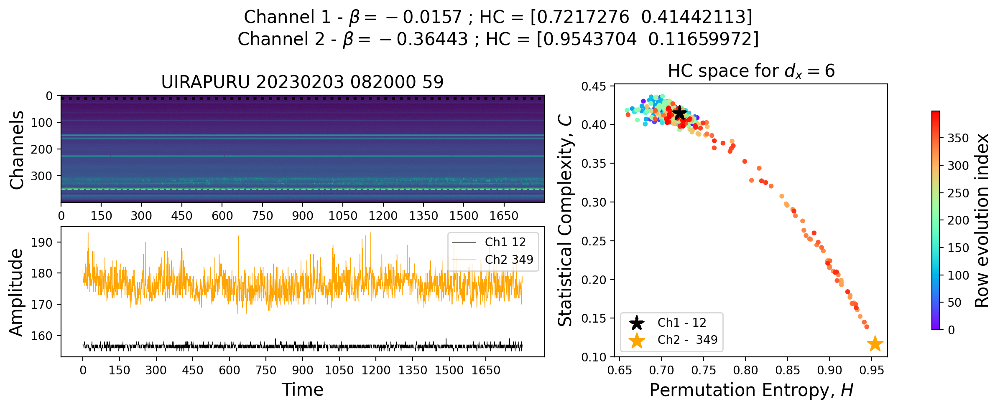

In [139]:
dx = 4
channel1 = 12
channel2 = 349
plot_3D = False
# for channel1 in range(0, np.shape(image_data)[0]):
fontsize = 15



plt.figure(figsize=(12,5),dpi=200)
hc_waterfall[dx]
gs = gridspec.GridSpec(2,5) 

plt.suptitle(f'Channel 1 - $\\beta = {round(betas_waterfall[channel1],5)}$ ; HC = {hc_waterfall[dx][channel1]}\nChannel 2 - $\\beta = {round(betas_waterfall[channel2],5)}$ ; HC = {hc_waterfall[dx][channel2]}', y=.97,fontsize=fontsize)

#Waterfall plot
ax1 = plt.subplot(gs[0, 0:3])
ax1.imshow(image_data)#, cmap='oranges')#, norm=norm)
ax1.axhline(channel2, color='orange', alpha=1,linewidth=1, linestyle='--')
ax1.axhline(channel1, color='black',   alpha=1,linewidth=2.5,linestyle=':')
ax1.set_title('UIRAPURU 20230203 082000 59',fontsize=fontsize)
# ax1.set_xlabel('Time',fontsize=fontsize)
ax1.set_ylabel('Channels',fontsize=fontsize)

# Time series
ax2 = plt.subplot(gs[1, 0:3])
ax2.plot(image_data[channel1], color='black',alpha=1,linewidth=0.5,label=f'Ch1 {channel1}')
ax2.plot(image_data[channel2], color='orange',alpha=1,linewidth=0.5,label=f'Ch2 {channel2}')
# ax2.set_ylim(np.min(image_data),np.max(image_data))
# ax2.set_title(f'Channel1 {channel1}',fontsize=fontsize)
ax2.set_xlabel('Time',fontsize=fontsize)
ax2.set_ylabel('Amplitude',fontsize=fontsize)
ax2.legend(fontsize=fontsize-5)
#Sactter ploting 2d ou 3d
if plot_3D:
    ax3 = plt.subplot(gs[:, 3:5]
                      ,projection='3d')
    sc = ax3.scatter(hc_waterfall[dx][:, 0], hc_waterfall[dx][:, 1], betas_waterfall, c=np.arange(len(hc_waterfall[dx])), cmap='rainbow', s=10)
    cbar = plt.colorbar(sc, ax=ax3, orientation='vertical')
    ax3.scatter(hc_waterfall[dx][channel1, 0], hc_waterfall[dx][channel1, 1], betas_waterfall[channel1], c='k', s=20,
                marker='*', edgecolor='k', linewidth=2, label=f'Ch {channel1}',zorder=[1000,1000,1000])
    cbar.set_label('Row evolution index',fontsize=fontsize)
    #Set z label and ticks on the left side of the plot
    ax3.set_zlabel('Betas $\\beta$',labelpad=-170,rotation=45,fontsize=fontsize)
    ax3.set_zticks([0,0.5,1.0])
    ax3.set_title('HC space with Betas Waterfall',fontsize=fontsize)
else:
    ax3 = plt.subplot(gs[:, 3:5])
    ax3.scatter(hc_waterfall[dx][:,0],hc_waterfall[dx][:,1],c = np.arange(len(hc_waterfall[dx])),cmap='rainbow',s=10)
    ax3.scatter(hc_waterfall[dx][channel1,0],hc_waterfall[dx][channel1,1],c = 'k',s=200,marker='*',label = f'Ch1 - {channel1}',edgecolor='k',linewidth=1,linestyle='--')  
    ax3.scatter(hc_waterfall[dx][channel2,0],hc_waterfall[dx][channel2,1],c = 'orange',s=200,marker='*',label = f'Ch2 -  {channel2}')   
    cbar = plt.colorbar(ax3.get_children()[0], ax=ax3, orientation='vertical',label='Row evolution index',fraction=0.046, pad=0.04, aspect=30, shrink=0.8, anchor=(5, 0.5))
    
    cbar.set_label('Row evolution index',fontsize=fontsize)
    ax3.set_title(f'HC space for $d_x = {dxs[dx]}$',fontsize=fontsize)
     
ax3.set_xlabel('Permutation Entropy, $H$',fontsize=fontsize)
ax3.set_ylabel('Statistical Complexity, $C$',fontsize=fontsize)
ax3.legend(fontsize=fontsize-5,loc='lower left',)

#Set ax1 and ax2 whit the same x_ticks
ax1.set_xticks(np.arange(0, np.shape(image_data)[1], 150))
ax2.set_xticks(np.arange(0, np.shape(image_data)[1], 150))
plt.tight_layout()
# plt.savefig(f'figuras/HC_PSD_waterfall.png')#, dpi=300)
# plt.savefig(f'figuras/HC_PSD_waterfall.pdf', dpi=300)
plt.show()


<ipython-input-60-08d73a49a13c>:32: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(w_pad=10, h_pad=100)


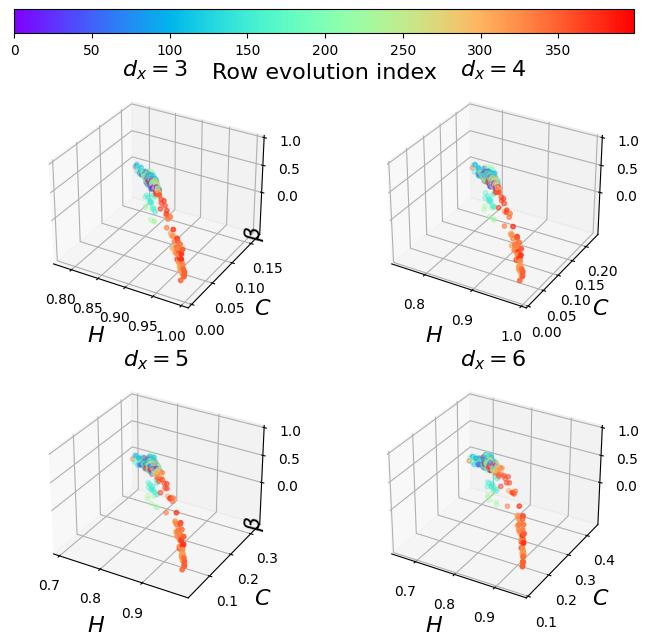

In [60]:
import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.gridspec as gridspec
fontsize = 16
# Assuming hc_waterfall, betas_waterfall, and dxs are defined previously in your code

plt.figure(figsize=(8,  8), dpi=100)
gs = gridspec.GridSpec(3, 2, height_ratios=[0.1, 1, 1], hspace=.3)

for dx in range(1,5):
    hc_waterfall[dx]
    channel1 = 349
    ax = plt.subplot(gs[dx + 1], projection='3d')
    sc = ax.scatter(hc_waterfall[dx][:, 0], hc_waterfall[dx][:, 1], betas_waterfall, 
                    c=np.arange(len(hc_waterfall[dx])), cmap='rainbow', s=10)
    # ax.scatter(hc_waterfall[dx][channel1, 0], hc_waterfall[dx][channel1, 1], betas_waterfall[channel1], 
    #            c='k', s=200, marker='*', edgecolor='k', linewidth=2, label=f'Ch {channel1}', zorder=[1000,1000,1000])
    ax.set_zlabel('$\\beta$', fontsize=fontsize, labelpad=-165)
    ax.set_zticks([0, 0.5, 1.0])
    ax.set_title(f'$d_x = {dxs[dx]}$', fontsize=fontsize)
    ax.set_xlabel('$H$', fontsize=fontsize)
    ax.set_ylabel('$C$', fontsize=fontsize)
    # if dx == 0:
    #     ax.legend(fontsize=fontsize loc='lower left')

# Create the horizontal color bar above the plots
cbar_ax = plt.subplot(gs[0, :])
cbar = plt.colorbar(sc, cax=cbar_ax, orientation='horizontal')
cbar.set_label('Row evolution index', fontsize=fontsize)

plt.tight_layout(w_pad=10, h_pad=100)
# plt.savefig('figuras/HC_PSD_3D_waterfall.png', dpi=300)
# plt.savefig('figuras/HC_PSD_3D_waterfall.pdf', dpi=300)
plt.show()


<ipython-input-204-ce0406940c86>:28: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


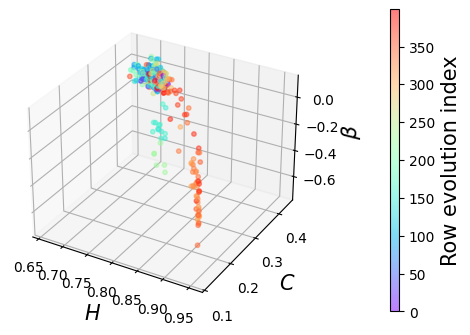

In [204]:
import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.gridspec as gridspec
fontsize = 15
# Assuming hc_waterfall, betas_waterfall, and dxs are defined previously in your code

plt.figure(figsize=(6, 4), dpi=100)
gs = gridspec.GridSpec(1, 2, width_ratios=[1, 0.02], wspace=.01)
dx = 4
hc_waterfall[dx]
channel1 = 349

ax = plt.subplot(gs[0,0] ,projection='3d')
sc = ax.scatter(hc_waterfall[dx][:, 0], hc_waterfall[dx][:, 1], betas_waterfall, c=np.arange(len(hc_waterfall[dx])), cmap='rainbow', s=10,alpha=.5)
# cbar = plt.colorbar(ax.get_children()[0], ax=ax)#, orientation='vertical',label='Row evolution index')#,fraction=0.046, pad=0.04, aspect=30, shrink=0.8, anchor=(5, 0.5))
# cbar.set_label('Row evolution index',fontsize=fontsize,y=0.35,x=1.5)
cbar_ax = plt.subplot(gs[0, 1])
cbar = plt.colorbar(sc, cax=cbar_ax, orientation='vertical')
cbar.set_label('Row evolution index', fontsize=fontsize)
ax.set_xlabel('$H$',fontsize=fontsize)
ax.set_ylabel('$C$',fontsize=fontsize)
ax.set_zlabel('$\\beta$',
            #   labelpad=-170,
              rotation=45,fontsize=fontsize)
plt.savefig('figuras/HC_PSD_3D_waterfall.png', dpi=300)
plt.savefig('figuras/HC_PSD_3D_waterfall.pdf', dpi=300)
plt.tight_layout()
plt.show()


<ipython-input-127-a60f46ed2ce9>:22: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()#w_pad=10, h_pad=100)


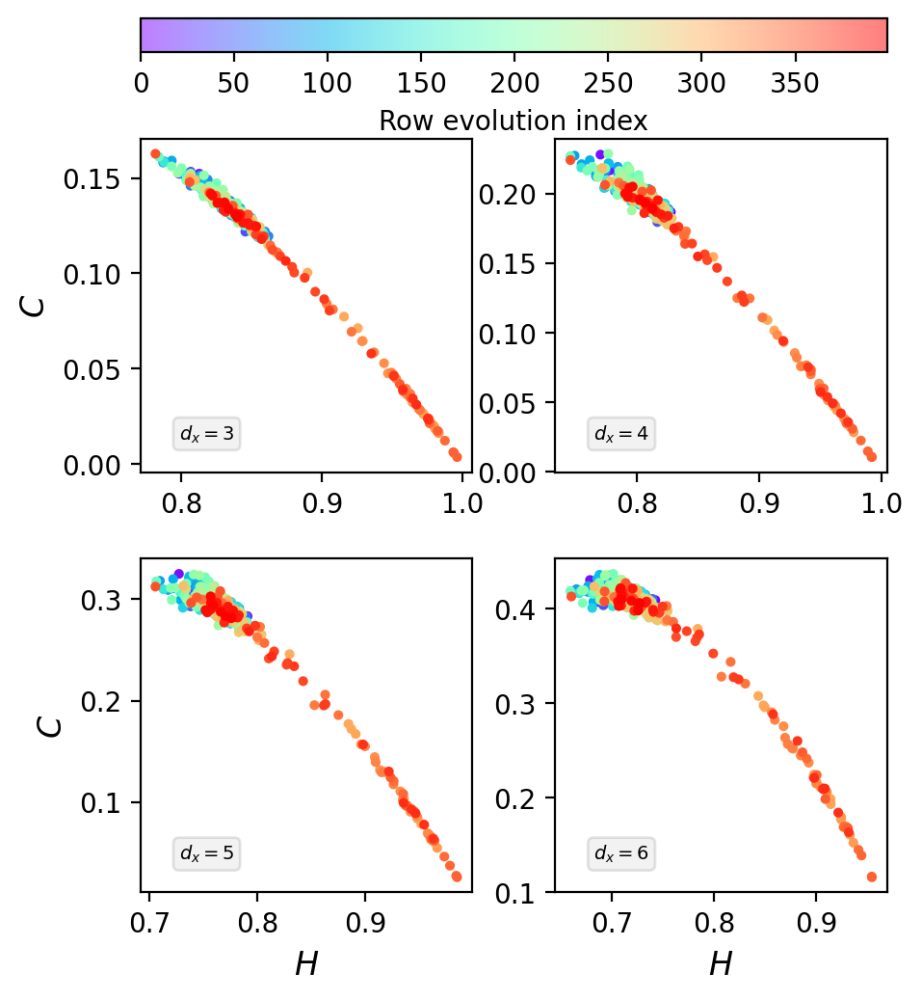

In [127]:

import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.gridspec as gridspec
fontsize = 12
plt.figure(figsize=(5, 6), dpi=200)
gs = gridspec.GridSpec(3, 2,  height_ratios=[.1, 1, 1], hspace=.37,wspace=.25)
for dx in range(1,5):
    hc_waterfall[dx]
    channel1 = 349
    ax = plt.subplot(gs[dx + 1])
    ax.scatter(hc_waterfall[dx][:,0],hc_waterfall[dx][:,1],c = np.arange(len(hc_waterfall[dx])),cmap='rainbow',s=7)
    ax.set_title(f'$d_x = {dxs[dx]}$', fontsize=fontsize-5,y=0.05,x=0.2,loc='center',bbox=dict(facecolor='gray', alpha=0.1, edgecolor='black', boxstyle='round,pad=0.3'))
    if dxs[dx] == 5 or dxs[dx] == 6:
        ax.set_xlabel('$H$', fontsize=fontsize)
    if dxs[dx] == 3 or dxs[dx] == 5:        
        ax.set_ylabel('$C$', fontsize=fontsize)
cbar_ax = plt.subplot(gs[0, :])
cbar = plt.colorbar(sc, cax=cbar_ax, orientation='horizontal')
cbar.set_label('Row evolution index', fontsize=None,y=1.3)

plt.tight_layout()#w_pad=10, h_pad=100)
plt.savefig('figuras/HC_2D_waterfall.png', dpi=300)
plt.savefig('figuras/HC_2D_waterfall.pdf', dpi=300)
plt.show()


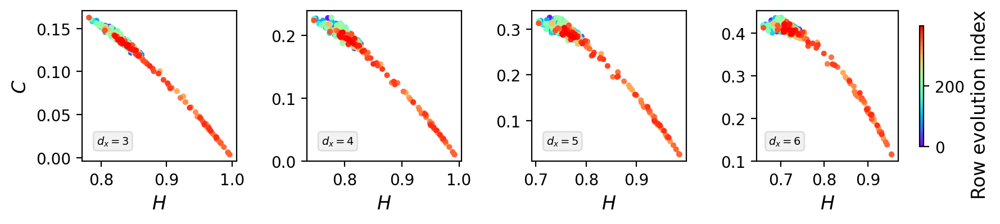

In [169]:

import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.gridspec as gridspec

fontsize = 12
plt.figure(figsize=(9, 2.1), dpi=200)
gs = gridspec.GridSpec(1, 4, #height_ratios=[.1, 1], 
                       #hspace=.6,
                    #    wspace=.45
                       )
for dx in range(1, 5):
    ax = plt.subplot(gs[0,dx - 1])
    sc = ax.scatter(hc_waterfall[dx][:, 0], hc_waterfall[dx][:, 1], 
                    c=np.arange(len(hc_waterfall[dx])), cmap='rainbow', s=7)
    ax.set_title(f'$d_x = {dxs[dx]}$', fontsize=fontsize-5, y=0.05, x=0.2, 
                 loc='center', bbox=dict(facecolor='gray', alpha=0.1, edgecolor='black', boxstyle='round,pad=0.3'))
    ax.set_xlabel('$H$', fontsize=fontsize)
    if dxs[dx] == 3:
        ax.set_ylabel('$C$', fontsize=fontsize)
cbar = plt.colorbar(ax.get_children()[0], ax=ax, orientation='vertical',label='Row evolution index',fraction=0.046, pad=0.04, aspect=30, shrink=0.8, anchor=(5, 0.5))
cbar.set_label('Row evolution index',fontsize=fontsize,y=0.35)
plt.tight_layout()
plt.savefig('figuras/HC_2D_waterfall.png', dpi=300)
plt.savefig('figuras/HC_2D_waterfall.pdf', dpi=300)
plt.show()


In [141]:
import plotly.graph_objects as go
import numpy as np

fig = go.Figure()

# Adicionar os pontos do scatter plot
fig.add_trace(go.Scatter3d(
    x=hc_waterfall[:, 0],
    y=hc_waterfall[:, 1],
    z=betas_waterfall,
    mode='markers',
    marker=dict(
        size=5,
        color=np.arange(len(hc_waterfall)),
        colorscale='Rainbow',
        opacity=0.8
    )
))

# Adicionar o ponto de destaque
fig.add_trace(go.Scatter3d(
    x=[hc_waterfall[channel, 0]],
    y=[hc_waterfall[channel, 1]],
    z=[betas_waterfall[channel]],
    mode='markers',
    marker=dict(
        size=15,
        color='yellow',
        symbol='diamond',  # Usar um símbolo permitido
        line=dict(
            color='red',
            width=2
        )
    ),
    name=f'Ch {channel}'
))

# Configurar o layout do gráfico
fig.update_layout(
    scene=dict(
        xaxis_title='Permutation Entropy, H',
        yaxis_title='Statistical Complexity, C',
        zaxis_title='Betas Waterfall'
    ),
    title='HC space with Betas Waterfall'
)

fig.show()


  0%|          | 0/4 [00:00<?, ?it/s]

0


100%|██████████| 400/400 [00:30<00:00, 13.13it/s]


i1 399


 25%|██▌       | 1/4 [00:32<01:38, 32.94s/it]

i2 399
1


100%|██████████| 400/400 [00:34<00:00, 11.69it/s]


i1 399


 50%|█████     | 2/4 [01:09<01:09, 34.91s/it]

i2 399
2


100%|██████████| 400/400 [00:35<00:00, 11.32it/s]


i1 399


 75%|███████▌  | 3/4 [01:46<00:35, 35.97s/it]

i2 399
3


100%|██████████| 400/400 [00:37<00:00, 10.59it/s]


i1 399


100%|██████████| 4/4 [02:26<00:00, 36.55s/it]


i2 399


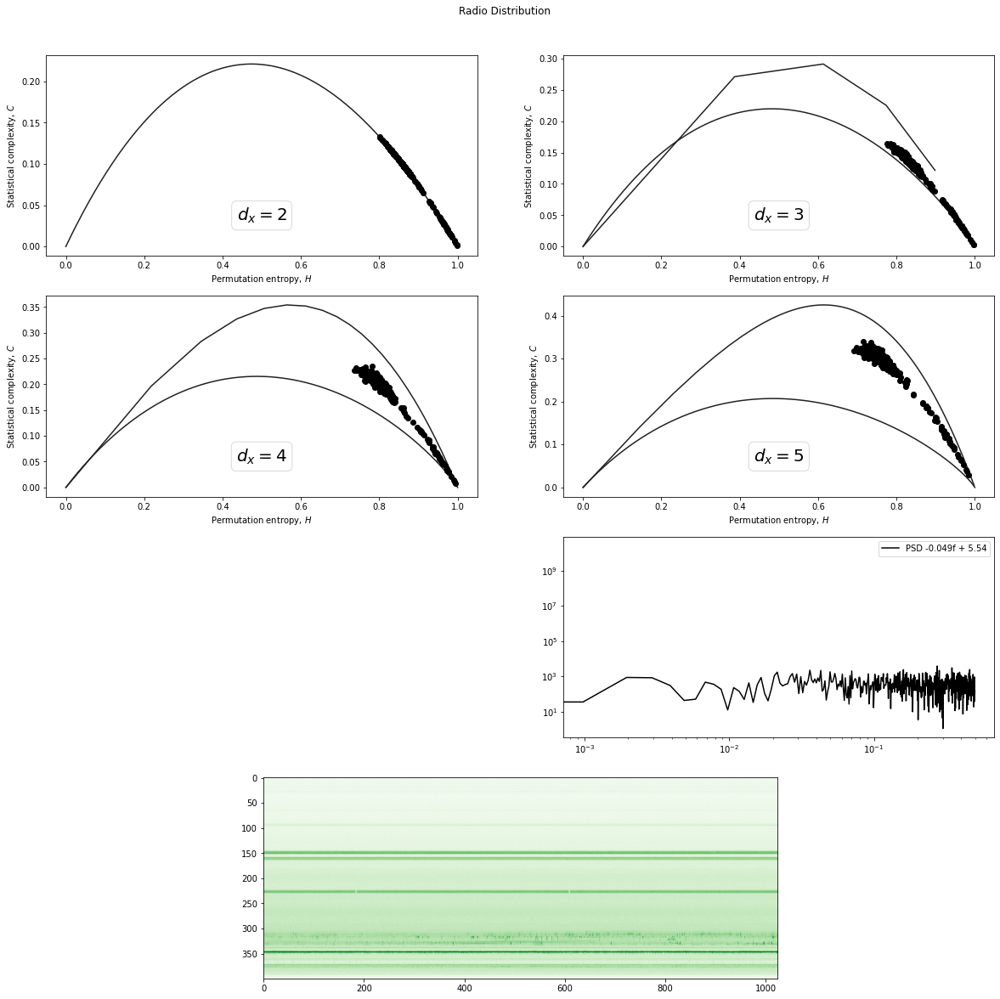

In [15]:
from tqdm import tqdm
plt.figure(figsize=(20,20))
plt.suptitle('Radio Distribution',y=0.92)
dxs = [2,3,4,5]
for j in tqdm(range(len(dxs))):
    print(j)
    hc_waterfall = []
    for i in tqdm(range(len(image_data))): hc_waterfall.append(np.mean([complexity_entropy(image_data[i], dx=dxs[j]) for _ in range(10)],axis=0)) 
    print('i1',i)
    plt.subplot(4,2,j+1)
    for i in tqdm(range(len(hc_waterfall))): plt.scatter(hc_waterfall[i][0],hc_waterfall[i][1],label = 'Waterfall', color = 'k')
    print('i2',i)
    plot_hc(dxs[j])
# plt.subplot(4,2,5)
# plt.hist(radio)
plt.subplot(4,2,6)
plot_psd(image_data[0])
plt.legend()
plt.subplot(4,2,(7,8))
plt.imshow(image_data, cmap='Greens')#, norm=norm)
plt.show()

# FRB
1 - Take FRB data

2 - Plot on the HC plane

3 - try to plot_it without the Burst

4 - Compare

In [102]:
#Import Librarys
import pandas as pd
import seaborn as sns
import numpy as np
from scipy.stats import norm
import io
import matplotlib.pyplot as plt
import matplotlib.mlab as mlab
from matplotlib.pyplot import figure
import h5py
import scipy
from scipy import signal
import matplotlib.pyplot as plt
from matplotlib import gridspec
from sklearn.preprocessing import MinMaxScaler, MaxAbsScaler
import gdown

## Download Herta Catalog

Here we can decide what data we will use

In [161]:
#!wget "https://www.herta-experiment.org/frbstats/catalogue.csv"
#!wget "https://storage.googleapis.com/chimefrb-dev.appspot.com/catalog1/chimefrbcat1.csv"

#data = pd.read_csv('chimefrbcat1.csv') 
data = pd.read_csv('catalogue.csv') 
df = pd.DataFrame(data)
#Sort by Flux
df = df.sort_values(by=['flux'], ascending=False)

df.head()
max_flux = df.frb[0:6].values 
min_flux = df.frb[-5:].values
#Join max_flux and min_flux in one array
extra = ['FRB 20181213C', 'FRB 20190630D','FRB 20181219B','FRB 20181214D', 'FRB 20181213A']
max_min_flux = np.concatenate((max_flux,extra), axis=0)
max_min_flux


array(['FRB 20181226B', 'FRB 20190404B', 'FRB 20190303B', 'FRB 20190118A',
       'FRB 20171213A', 'FRB 20190417C', 'FRB 20181213C', 'FRB 20190630D',
       'FRB 20181219B', 'FRB 20181214D', 'FRB 20181213A'], dtype=object)

In [336]:
all_frbs = ['FRB20181220B','FRB20181220A','FRB20181219C','FRB20181219B','FRB20181219A','FRB20181218C','FRB20181218B','FRB20181218A','FRB20181217A','FRB20181216A','FRB20181215B','FRB20181215A','FRB20181214F','FRB20181214D','FRB20181214C','FRB20181214B','FRB20181214A','FRB20181213C','FRB20181213B','FRB20181213A','FRB20181209A','FRB20181208A','FRB20181203C','FRB20181203B','FRB20181203A','FRB20181202C','FRB20181202B','FRB20181202A','FRB20181201B','FRB20181201A','FRB20181130A','FRB20181129C','FRB20181129B','FRB20181129A','FRB20181128D','FRB20181128C','FRB20181128B','FRB20181128A','FRB20181127A','FRB20181126A','FRB20181125A','FRB20181124B','FRB20181124A','FRB20181123A','FRB20181122B','FRB20181122A','FRB20181120C','FRB20181120B','FRB20181119E','FRB20181119D','FRB20181119C','FRB20181119B','FRB20181119A','FRB20181118C','FRB20181118B','FRB20181118A','FRB20181117C','FRB20181117B','FRB20181117A','FRB20181116B','FRB20181116A','FRB20181115A','FRB20181104C','FRB20181104B','FRB20181104A','FRB20181102A','FRB20181101A','FRB20181030E','FRB20181030D','FRB20181030C','FRB20181030B','FRB20181030A','FRB20181028A','FRB20181027A','FRB20181025A','FRB20181022E','FRB20181022D','FRB20181022C','FRB20181020A','FRB20181019C','FRB20181019B','FRB20181019A','FRB20181018C','FRB20181018B','FRB20181018A','FRB20181017B','FRB20181017A','FRB20181015A','FRB20181014D','FRB20181014C','FRB20181014B','FRB20181014A','FRB20181013E','FRB20181013C','FRB20181013B','FRB20181013A','FRB20181012B','FRB20180928A','FRB20180925B','FRB20180925A','FRB20180924A','FRB20180923D','FRB20180923C','FRB20180923A','FRB20180922A','FRB20180921A','FRB20180920B','FRB20180920A','FRB20180919B','FRB20180919A','FRB20180918A','FRB20180917B','FRB20180917A','FRB20180916C','FRB20180916B','FRB20180916A','FRB20180915B','FRB20180915A','FRB20180911C','FRB20180911A','FRB20180910A','FRB20180909A','FRB20180908B','FRB20180907E','FRB20180907D','FRB20180907C','FRB20180907B','FRB20180907A','FRB20180906B','FRB20180906A','FRB20180904A','FRB20180817A','FRB20180814B','FRB20180814A','FRB20180812A','FRB20180810B','FRB20180810A','FRB20180806A','FRB20180801A','FRB20180730A','FRB20180729B','FRB20180729A','FRB20180727A','FRB20180725A']

In [162]:
#Take only BINGOs Frenquency
# df_freq = df.copy()
# BINGO_FREQ_MIN =  960
# BINGO_FREQ_MAX = 1260
# df_freq.drop(df_freq[df_freq['frequency'] > BINGO_FREQ_MAX].index, inplace = True)
# df_freq.drop(df_freq[df_freq['frequency'] < BINGO_FREQ_MIN].index, inplace = True)
#list = df_freq.frb.values
#df = df.sort_values(by=['flux'])
list = df.frb.values
list = max_min_flux
#list = max_flux
for i in range(len(list)): list[i] = list[i][0:3] + list[i][-9:]
list = list[0:10]
list

array(['FRB20181226B', 'FRB20190404B', 'FRB20190303B', 'FRB20190118A',
       'FRB20171213A', 'FRB20190417C', 'FRB20181213C', 'FRB20190630D',
       'FRB20181219B', 'FRB20181214D'], dtype=object)

In [173]:
#Prepare for Downloading
#frbs_adress = ['FRB20190701E','FRB20190701D','FRB20190701C','FRB20190701B','FRB20190701A','FRB20190630D'] 
frbs_adress = list
#frbs_adress = all_frbs

path = 'https://www.cadc-ccda.hia-iha.nrc-cnrc.gc.ca/files/vault/AstroDataCitationDOI/CISTI.CANFAR/21.0007/data/waterfalls/data/'
files = [] 
for i in range(len(frbs_adress)):files.append(f'{path}{frbs_adress[i]}_waterfall.h5')

In [174]:
for i in range(len(files)):
    #Check if file exists
    if os.path.isfile(f'{frbs_adress[i]}_waterfall.h5'):
        print(f'{frbs_adress[i]}_waterfall.h5 already exists')
    else:
        # #Downloading with `files` url
        try:
            gdown.download(files[i])
            print(f'{frbs_adress[i]}_waterfall.h5 DOWLOADED')
        except:
            print(f'{frbs_adress[i]}_waterfall.h5 ERROR IN URL')      

FRB20181226B_waterfall.h5 already exists
FRB20190404B_waterfall.h5 already exists
FRB20190303B_waterfall.h5 already exists
FRB20190118A_waterfall.h5 already exists
FRB20171213A_waterfall.h5 already exists
FRB20190417C_waterfall.h5 already exists
FRB20181213C_waterfall.h5 already exists
FRB20190630D_waterfall.h5 already exists
FRB20181219B_waterfall.h5 already exists
FRB20181214D_waterfall.h5 already exists


In [175]:
# #Downloading with `files` url
# for i in range(len(files)): 
#     try:
#         gdown.download(files[i])
#     except:
#         pass

In [176]:
# Definindo vetor vazio
#List all files with .h5 extension
#files = glob.glob('*.h5')
#files
file_name = []
# Alocando o nome dos arquivos que foram baixado
for i in range(len(files)): file_name.append(files[i][-25:])
for i in range(len(files)): file_name[i] = '/home/barauna/Documentos/PN_Vision_Noise/'+file_name[i]

In [178]:
file_name = file_name[1:]
len(file_name)

8

## Reading Dowloaded files

In [179]:
#Redind and alocatind data

wfalls           = []
model_specs      = [] 
eventnames       = []
wfalls           = []
model_wfalls     = []
plot_times       = []
plot_freqs       = []
tss              = []
model_tss        = []
specs            = []
model_specs      = []
extents          = []
dms              = []
scatterfits      = []
cal_obs_dates    = []
cal_source_names = []
cal_wfalls       = []

for i in range(len(file_name)):
  try:
    eventnames.append(       h5py.File(file_name[i], "r")["frb"].attrs["tns_name"].decode())
    wfalls.append(           h5py.File(file_name[i], "r")["frb"]["wfall"][:])
    model_wfalls.append(     h5py.File(file_name[i], "r")["frb"]["model_wfall"][:])
    plot_times.append(       h5py.File(file_name[i], "r")["frb"]["plot_time"][:])
    plot_freqs.append(       h5py.File(file_name[i], "r")["frb"]["plot_freq"][:])
    tss.append(              h5py.File(file_name[i], "r")["frb"]["ts"][:])
    model_tss.append(        h5py.File(file_name[i], "r")["frb"]["model_ts"][:])
    specs.append(            h5py.File(file_name[i], "r")["frb"]["spec"][:])
    model_specs.append(      h5py.File(file_name[i], "r")["frb"]["model_spec"][:])
    extents.append(          h5py.File(file_name[i], "r")["frb"]["extent"][:])
    dms.append(              h5py.File(file_name[i], "r")["frb"].attrs["dm"][()])
    scatterfits.append(      h5py.File(file_name[i], "r")["frb"].attrs["scatterfit"][()])
    cal_obs_dates.append(    h5py.File(file_name[i], "r")["frb"].attrs["calibration_observation_date"].decode())
    cal_source_names.append( h5py.File(file_name[i], "r")["frb"].attrs["calibration_source_name"].decode())
    cal_wfalls.append(       h5py.File(file_name[i], "r")["frb"]["calibrated_wfall"][:])
  except:
    pass

## Functions

In [180]:
#Creating the bin_frqs function
# Essa funação tem como somar os canais originais. 
def bin_freq_channels(data, fbin_factor=4):
    num_chan = data.shape[0]
    if num_chan % fbin_factor != 0:
        raise ValueError("frequency binning factor `fbin_factor` should be even")
    data = np.nanmean(data.reshape((num_chan // fbin_factor, fbin_factor) + data.shape[1:]), axis=1)
    return data

In [181]:
def clean_outliers(data, time_std=2, norm=True, in_row=True):
    if norm == True: 
        data        = (data - np.nanmin(data)) /(np.nanmax(data) - np.nanmin(data))     
    
    if in_row:        
        # Calculate the mean and standard deviation of each row
        mean = np.nanmean(data, axis=1, keepdims=True)
        std  = np.nanstd( data, axis=1, keepdims=True)

        # Set the threshold for replacing values
        threshold1 = mean + time_std * std
        threshold2 = mean - time_std * std

        # Loop through the data and replace any values above the threshold
        data_clean = np.copy(data)
        data_signal = np.zeros_like(data)
        for i in range(data.shape[0]):
            for j in range(data.shape[1]):
                if data_clean[i, j] > threshold1[i] or data_clean[i, j] < threshold2[i]: 
                    data_signal[i, j] = data_clean[i, j]
                    data_clean[i, j] = mean[i] + np.random.normal(scale=std[i]/2)
    
    else:
        # Calculate the mean and standard deviation of the data
        # mean = np.nanmean(data[0])
        # std = np.nanstd(data[0])

        mean = min(np.nanmean(data, axis=1, keepdims=True))
        std  = min(np.nanstd(data, axis=1, keepdims=True))

        # Set the threshold for replacing values
        threshold1 = mean + time_std * std
        threshold2 = mean - time_std * std

        # Loop through the data and replace any values above the threshold
        data_clean = np.copy(data)
        data_signal = np.zeros_like(data)
        for i in range(data.shape[0]):
            for j in range(data.shape[1]):
                if data_clean[i, j] > threshold1 or data_clean[i, j] < threshold2:
                    data_signal[i, j] = data_clean[i, j]
                    data_clean[i, j] = mean + np.random.normal(scale=std)
    
    return data, data_clean, data_signal


In [182]:
len(wfalls)

7

<ipython-input-180-444c7ba569ae>:7: RuntimeWarning: Mean of empty slice
  data = np.nanmean(data.reshape((num_chan // fbin_factor, fbin_factor) + data.shape[1:]), axis=1)
<ipython-input-181-d64605290c07>:28: RuntimeWarning: Mean of empty slice
  mean = min(np.nanmean(data, axis=1, keepdims=True))
<ipython-input-180-444c7ba569ae>:7: RuntimeWarning: Mean of empty slice
  data = np.nanmean(data.reshape((num_chan // fbin_factor, fbin_factor) + data.shape[1:]), axis=1)
<ipython-input-181-d64605290c07>:28: RuntimeWarning: Mean of empty slice
  mean = min(np.nanmean(data, axis=1, keepdims=True))
/home/barauna/anaconda3/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1664: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
<ipython-input-180-444c7ba569ae>:7: RuntimeWarning: Mean of empty slice
  data = np.nanmean(data.reshape((num_chan // fbin_factor, fbin_factor) + data.shape[1:]), axis=1)
<ipython-input-181-d64605290c07>:28:

<Figure size 720x1440 with 0 Axes>

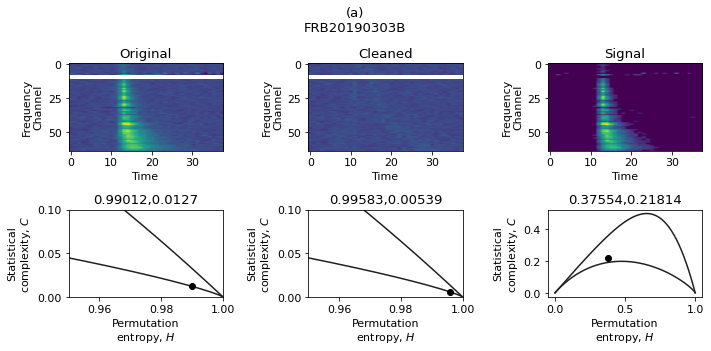

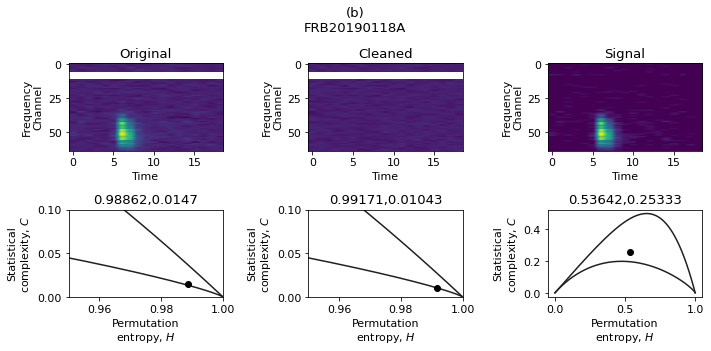

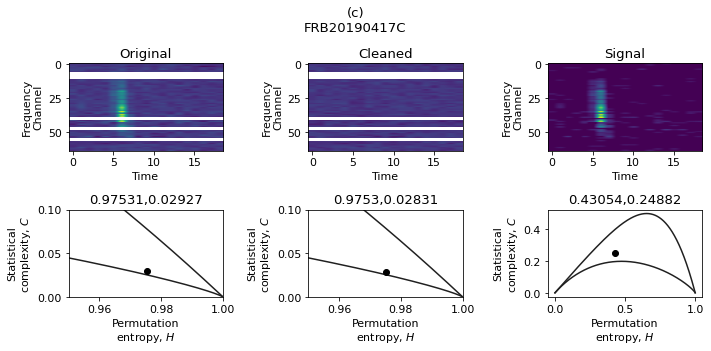

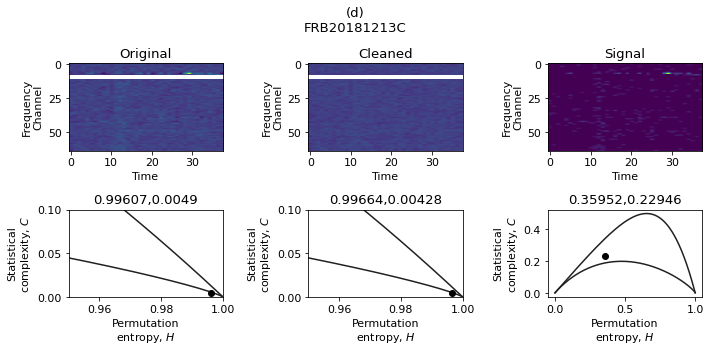

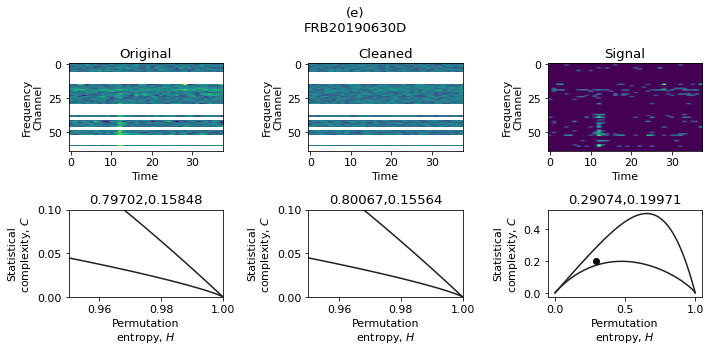

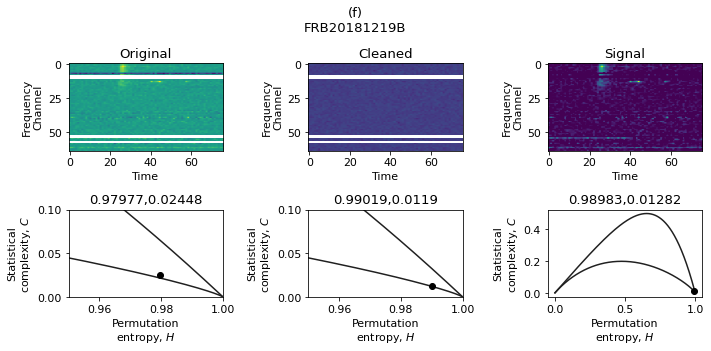

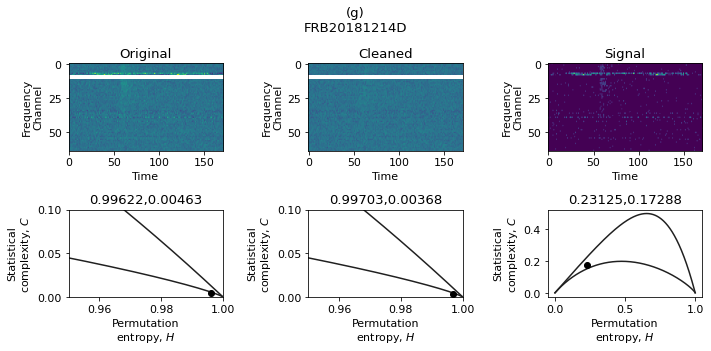

In [201]:
letters = ['(a)','(b)','(c)','(d)','(e)','(f)','(g)','(h)','(i)','(j)','(k)','(l)','(m)','(n)','(o)','(p)','(q)','(r)','(s)','(t)','(u)','(v)','(w)','(x)','(y)','(z)']
plt.figure(figsize=(10,20))
plt.rcParams.update({'font.size': 11})
for l in range(0,len(wfalls)):
    sigmas = 3
    dxs = 2
    data = bin_freq_channels(wfalls[l],2**8)
    #hc_data = complexity_entropy(data, dx = dxs,dy = dxs)
    a,b,c = clean_outliers(data,sigmas,norm=False,in_row=False)
    hc_a = complexity_entropy(a, dx = dxs,dy = dxs)
    hc_b = complexity_entropy(b, dx = dxs,dy = dxs)
    hc_c = complexity_entropy(c, dx = dxs,dy = dxs)
    plt.figure(figsize=(10,5))
    plt.suptitle(f'{letters[l]}\n{eventnames[l]}',y=0.97)
    plt.subplot(2,3,1)
    plt.imshow(a,vmin=np.nanmin(a),vmax=np.nanmax(a),aspect='auto')
    plt.ylabel('Frequency\nChannel')
    plt.xlabel('Time')
    plt.title('Original')
    plt.subplot(2,3,2)
    plt.imshow(b,vmin=np.nanmin(a),vmax=np.nanmax(a),aspect='auto')
    plt.title('Cleaned')
    plt.ylabel('Frequency\nChannel')
    plt.xlabel('Time')
    plt.subplot(2,3,3)
    plt.imshow(c,vmin=0,vmax=np.nanmax(a),aspect='auto')
    plt.title('Signal')
    plt.ylabel('Frequency\nChannel')
    plt.xlabel('Time')    
    plt.subplot(2,3,4)
    plt.scatter(hc_a[0],hc_a[1],c='k')
    plt.title(f'{round(hc_a[0],5)},{round(hc_a[1],5)}')
    plot_hc(dxs,False)
    plt.ylim(0,0.1)
    plt.xlim(0.95,1)
    plt.subplot(2,3,5)
    plt.scatter(hc_b[0],hc_b[1],c='k')
    plt.title(f'{round(hc_b[0],5)},{round(hc_b[1],5)}')
    plot_hc(dxs,False)
    plt.ylim(0,0.1)
    plt.xlim(0.95,1)
    plt.subplot(2,3,6)
    plt.scatter(hc_c[0],hc_c[1],c='k')
    plt.title(f'{round(hc_c[0],5)},{round(hc_c[1],5)}')
    plot_hc(dxs,False)
    # plt.ylim(0,0.1)
    # plt.xlim(0.95,1)
    plt.tight_layout()
    plt.savefig(f'HC_{eventnames[l]}.pdf',dpi=300,bbox_inches='tight')

<ipython-input-154-444c7ba569ae>:7: RuntimeWarning: Mean of empty slice
  data = np.nanmean(data.reshape((num_chan // fbin_factor, fbin_factor) + data.shape[1:]), axis=1)


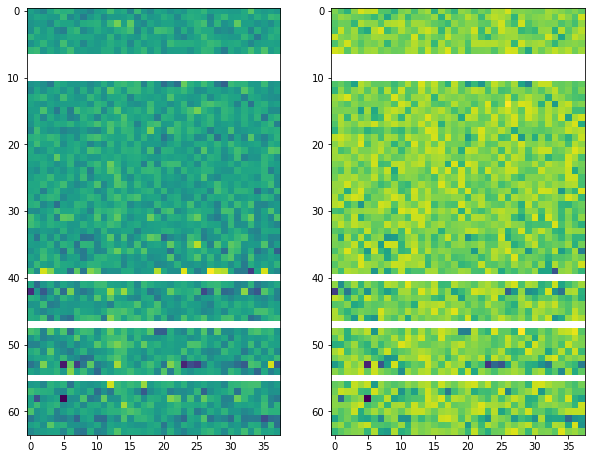

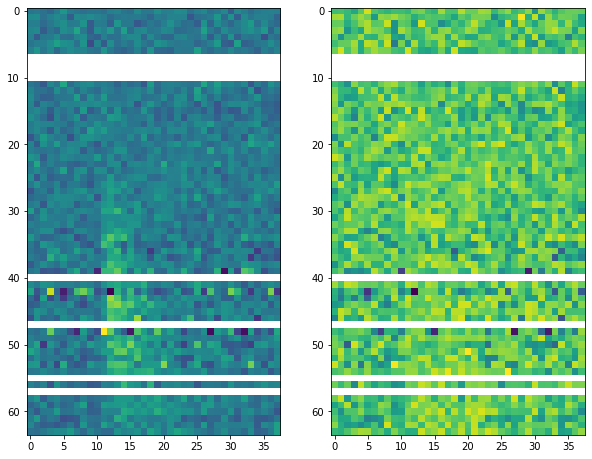

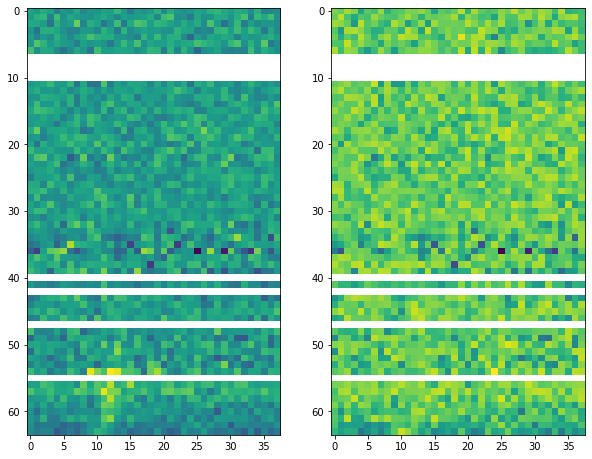

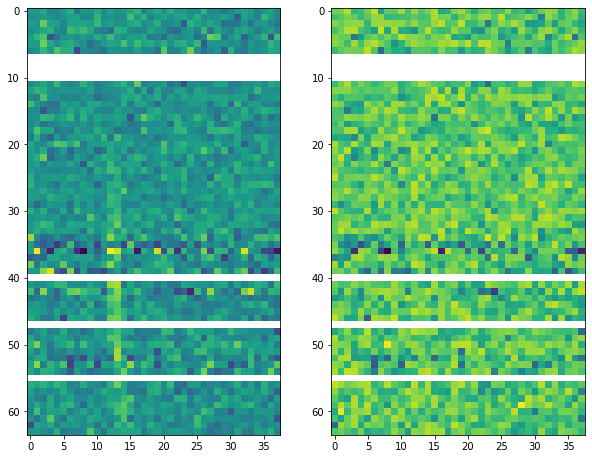

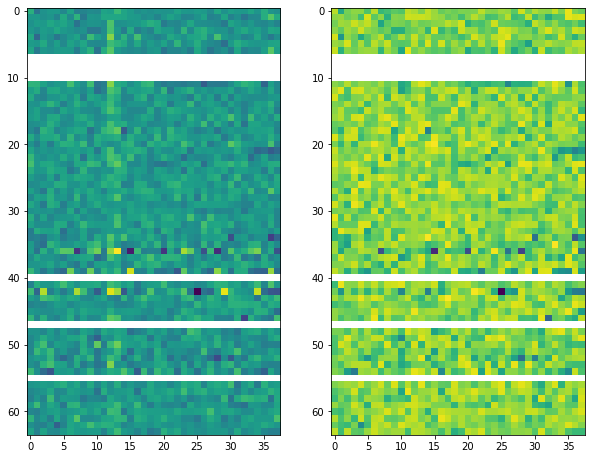

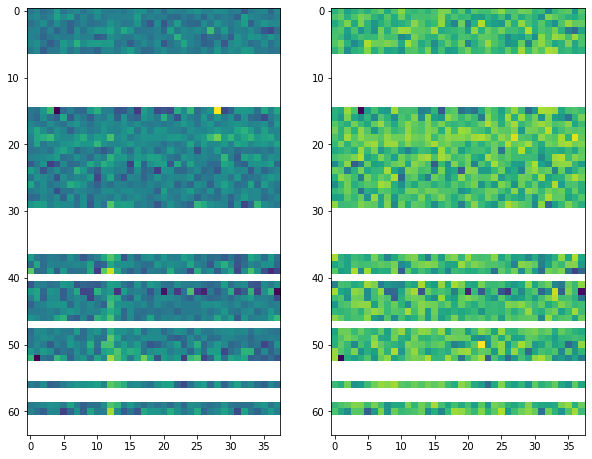

In [250]:
k = 3
for k in range(len(wfalls)):
    plt.figure(figsize=(10,10))
    plt.subplot(1,2,1)
    plt.imshow(bin_freq_channels(wfalls[k],256))
    plt.subplot(1,2,2)
    plt.imshow(wfalls_noise[k])

In [223]:
bin_freq_channels(wfalls[k],256)

TypeError: only integer scalar arrays can be converted to a scalar index

In [251]:
import numpy as np

def clean_outliers(data, norm=False):
    # Calculate the mean and standard deviation of the data
    mean = np.nanmean(data)
    std = np.nanstd(data)

    # Set the threshold for replacing values
    threshold = mean + 2 * std

    # Loop through the data and replace any values above the threshold
    for i in range(data.shape[0]):
        for j in range(data.shape[1]):
            if data[i, j] > threshold:
                data[i, j] = mean + np.random.normal(scale=std/2)
    
    # Normalize the data if requested
    if norm:
        data_norm = (data - np.min(data)) / (np.max(data) - np.min(data))
        return data_norm
    else:
        return data


In [244]:
wfalls_noise = []
for i in range(len(wfalls)): 
    wfalls_noise.append(clean_outliers(bin_freq_channels(wfalls[i],256),1))

<ipython-input-154-444c7ba569ae>:7: RuntimeWarning: Mean of empty slice
  data = np.nanmean(data.reshape((num_chan // fbin_factor, fbin_factor) + data.shape[1:]), axis=1)


<ipython-input-6-444c7ba569ae>:7: RuntimeWarning: Mean of empty slice
  data = np.nanmean(data.reshape((num_chan // fbin_factor, fbin_factor) + data.shape[1:]), axis=1)


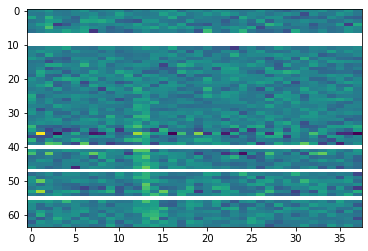

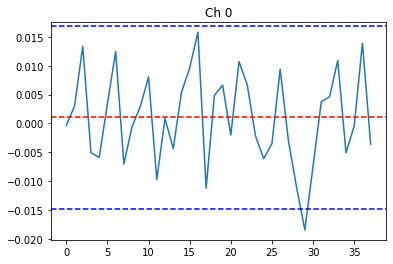

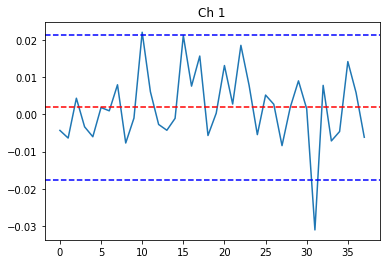

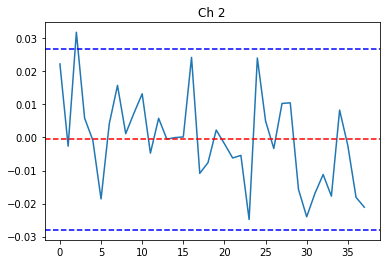

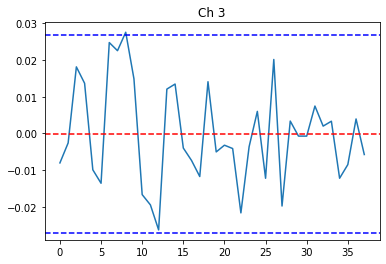

...

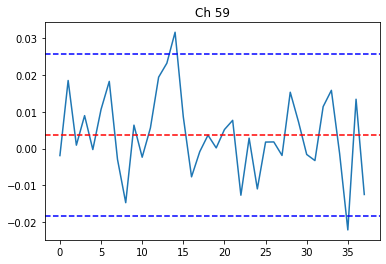

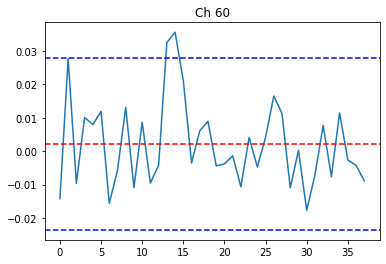

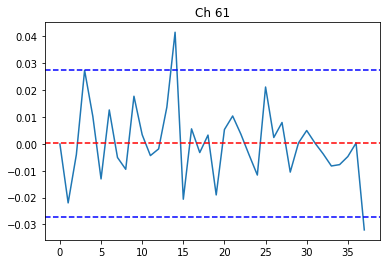

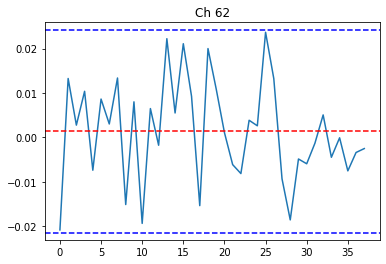

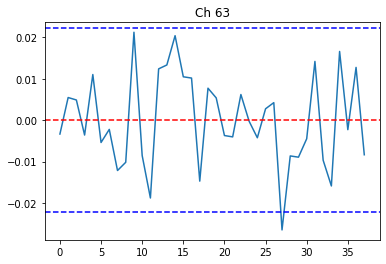

IndexError: index 64 is out of bounds for axis 0 with size 64

In [128]:
#plt.figure(figsize=(10,10),dpi=80)
plt.imshow(bin_freq_channels(wfalls[k],256),aspect='auto')
plt.show()
len(bin_freq_channels(wfalls[k],256))
k = 3
for i in range(len(wfalls[k])):
    plt.plot(bin_freq_channels(wfalls[k],256)[i])
    plt.title(f'Ch {i}')
    plt.axhline(y=np.mean(bin_freq_channels(wfalls[k],256)[i]),linestyle='--',color='r')
    plt.axhline(y=np.mean(bin_freq_channels(wfalls[k],256)[i])+2*np.std(bin_freq_channels(wfalls[k],256)[i]),linestyle='--',color='b')
    plt.axhline(y=np.mean(bin_freq_channels(wfalls[k],256)[i])-2*np.std(bin_freq_channels(wfalls[k],256)[i]),linestyle='--',color='b')
    plt.show()

In [126]:
def clean_timeseries(ts,times_sts=2):
    '''
    Fuction to clear outliers largers then `times_std` times the standart deviation
    '''
    mean = np.mean(ts)
    std = np.std(ts)
    ts_copy = ts.copy()
    threshold = times_sts * std
    for i in range(len(ts_copy)):
        if np.abs(ts_copy[i] - mean) > threshold:
            ts_copy[i] = mean + np.random.normal(0, std/2)
    return ts_copy


In [ ]:
wfalls[0] clean_timeseries

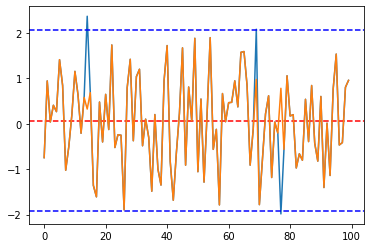

In [79]:
import numpy as np

# Generate a sample time series
ts = np.random.normal(0, 1, size=100)

# Calculate the mean and standard deviation of the time series
mean = np.mean(ts)
std = np.std(ts)

# Define the threshold value
threshold = 2 * std

# Create a copy of the time series
ts_copy = ts.copy()

# Replace values that exceed the threshold with mean + noise
for i in range(len(ts_copy)):
    if np.abs(ts_copy[i] - mean) > threshold:
        ts_copy[i] = mean + np.random.normal(0, std/2)

# Return the modified time series
print(ts_copy)

plt.plot(ts)
plt.axhline(np.mean(ts),linestyle='--',c='r')
plt.axhline(np.mean(ts)+2*np.std(ts),linestyle='--',c='b')
plt.axhline(np.mean(ts)-2*np.std(ts),linestyle='--',c='b')
plt.plot(ts_copy)



<ipython-input-6-444c7ba569ae>:7: RuntimeWarning: Mean of empty slice
  data = np.nanmean(data.reshape((num_chan // fbin_factor, fbin_factor) + data.shape[1:]), axis=1)


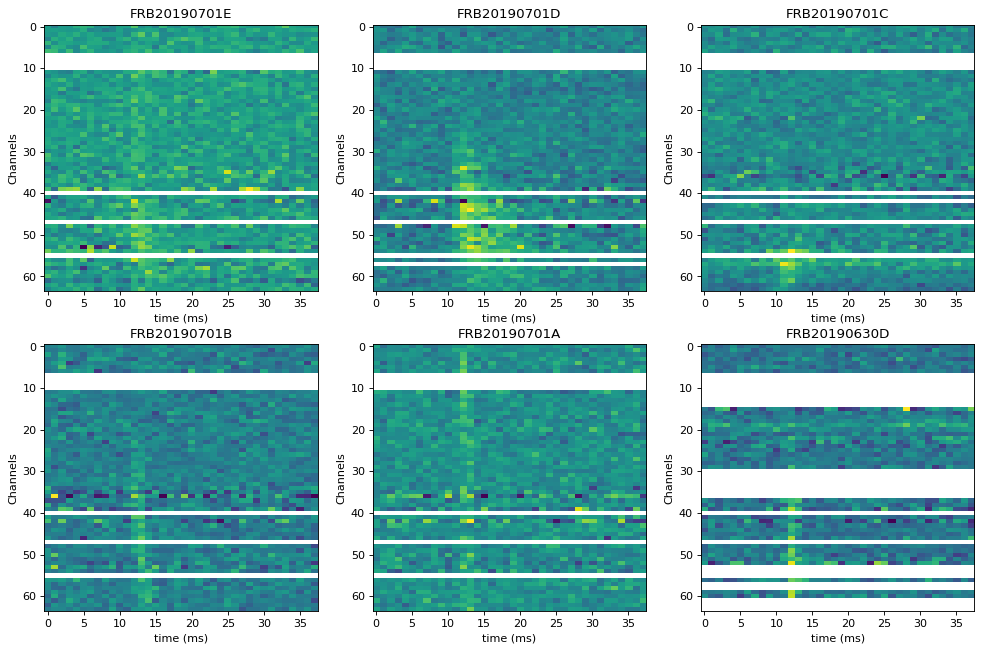

In [7]:
#Ploting FRBS Waterfall
n_rows, n_collums = 3,3
bins = 256
plt.figure(figsize=(15,15),dpi=80)
for i in range(len(files)):
  x = bin_freq_channels(wfalls[i],bins)
  plt.subplot(n_rows,n_collums,i+1)
  plt.imshow(x, aspect="auto")
  plt.title(eventnames[i])
  plt.ylabel('Channels')
  plt.xlabel('time (ms)')
  #plt.yticks(400, 500, 600, 700, 800])

In [8]:
markers = ['o', 'v', '^', '<', '>', 's', 'p', '*', 'h', 'H', 'D', 'd', 'P', 'X']

<ipython-input-110-444c7ba569ae>:7: RuntimeWarning: Mean of empty slice
  data = np.nanmean(data.reshape((num_chan // fbin_factor, fbin_factor) + data.shape[1:]), axis=1)


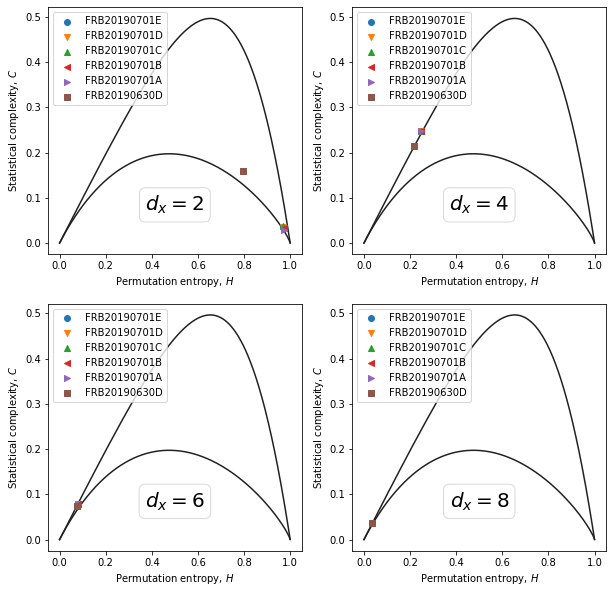

In [115]:
dx = [2,4,6,8]
plt.figure(figsize=(10,10))
for k in range(len(dx)):
    plt.subplot(2,2,k+1)
    hc_frbs = []
    for i in range(len(files)):
      frb = bin_freq_channels(wfalls[i],bins)
      hc_frbs.append(np.mean([complexity_entropy(frb, dx=dx[k], dy=dx[k]) for _ in range(10)],axis=0))
    for j in range(len(hc_frbs)):
        plt.scatter(hc_frbs[j][0], hc_frbs[j][1],marker=markers[j],label = eventnames[j])
        plt.legend()
    plot_hc(dx[k])  

<ipython-input-59-444c7ba569ae>:7: RuntimeWarning: Mean of empty slice
  data = np.nanmean(data.reshape((num_chan // fbin_factor, fbin_factor) + data.shape[1:]), axis=1)


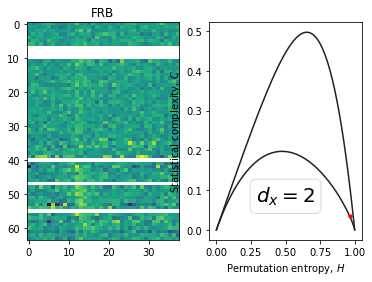

In [81]:

frb = bin_freq_channels(wfalls[0],bins)
hc_frb = np.mean([complexity_entropy(frb, dx=2, dy=2) for _ in range(10)],axis=0)
plt.subplot(1,2,1)
plt.imshow(frb , aspect="auto")
plt.title('FRB')
plt.subplot(1,2,2)
plt.scatter(hc_frb[0], hc_frb[1], c='r', s=10)
plot_hc(dx=2)